In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
%run imports_notebook.py

In [3]:
from image_cppn import ImageCPPN, PixelDOFs

In [4]:
# def get_new_dofs(n_batches, img_size=(224, 224), representation='cppn'):
#     if representation=='cppn':
#     elif representation=='pixel':
#         return PixelDOFs(n_batches=4, img_size=img_size)
#     else:
#         raise NotImplementedError()
cppn_params = dict(n_hidden=100, n_layers=20, activation=torch.tanh, normalization='coordinate', residual=False)
# cppn_params = dict(n_hidden=100, n_layers=20, activation=torch.relu, normalization='coordinate', residual=True)

# dofs = ImageCPPN(n_batches=4, **cppn_params)
# dofs = PixelDOFs(n_batches=4, img_size=img_size)

# Fitting a CPPN to an real given image directly (MSE Loss)

torch.Size([4, 3, 64, 64])


  0%|          | 0/800 [00:00<?, ?it/s]

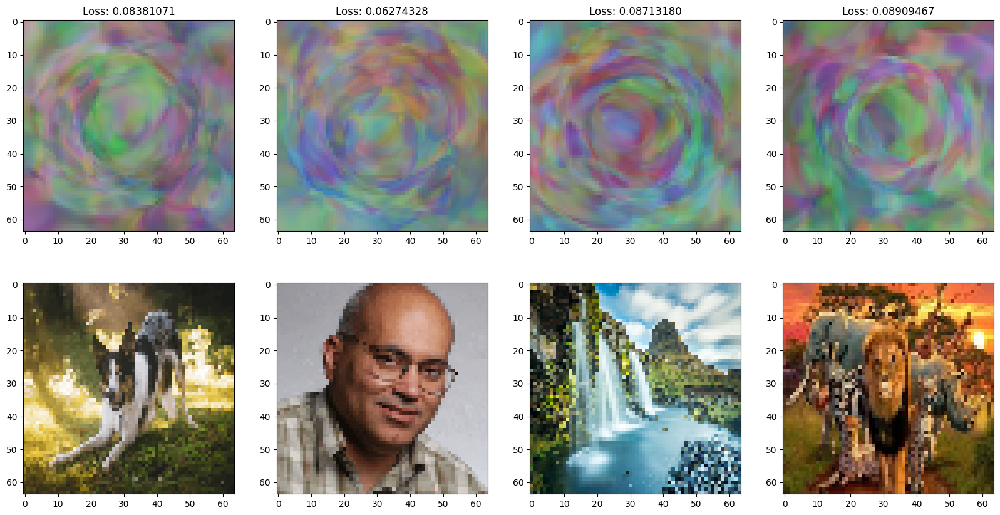

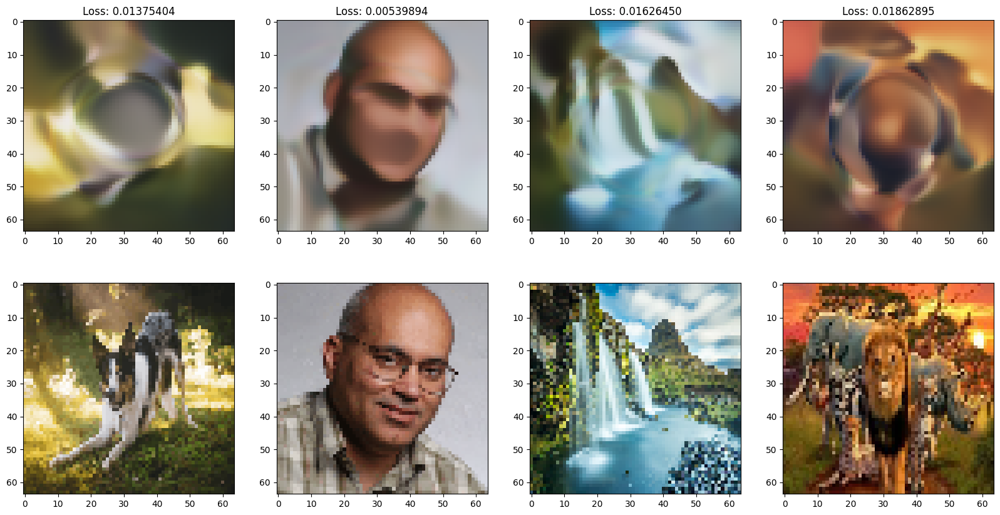

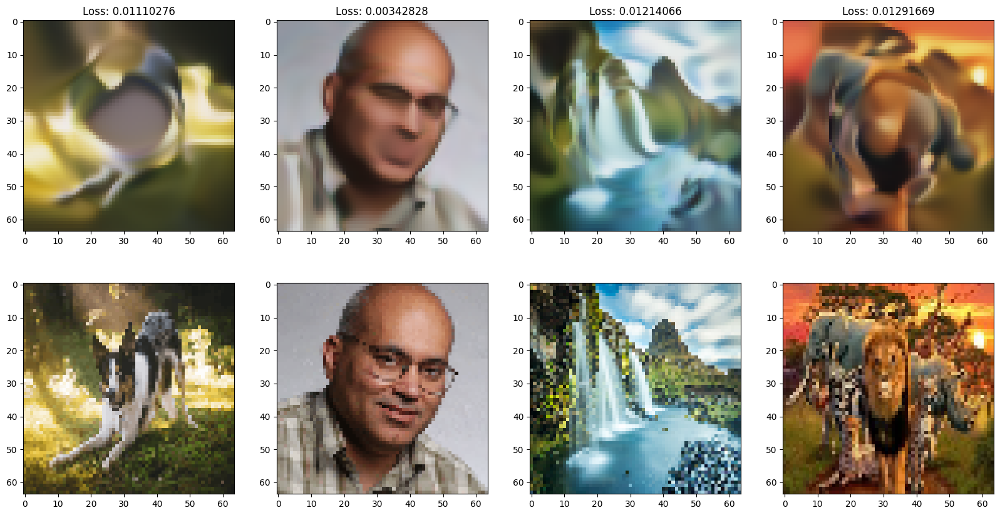

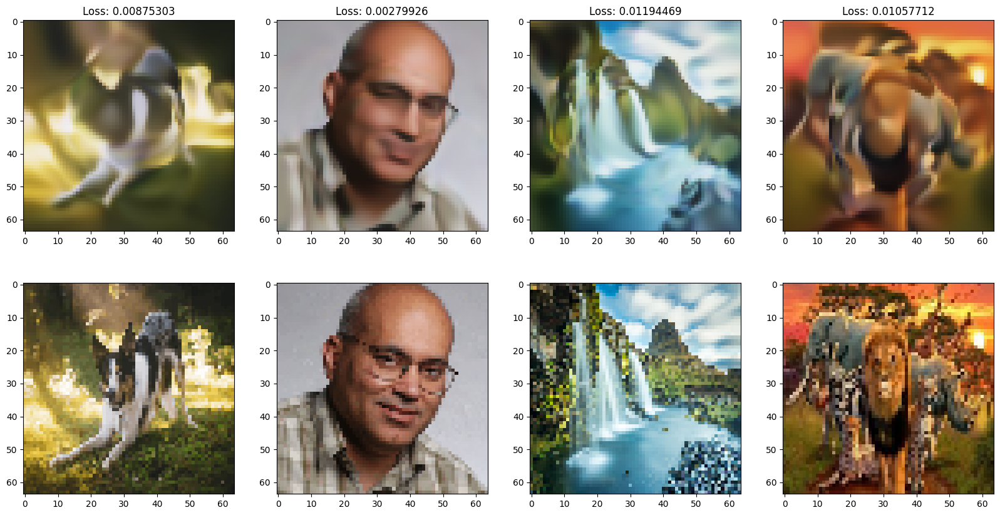

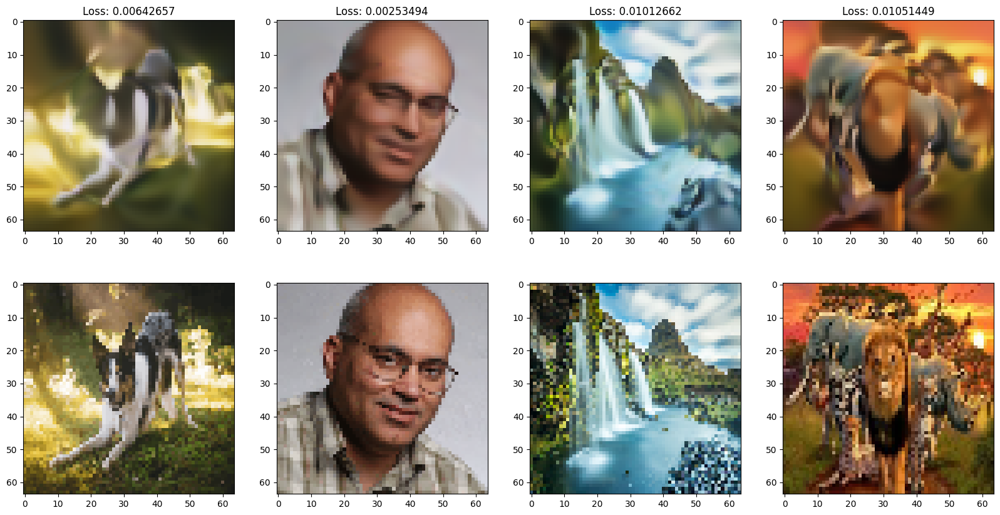

...

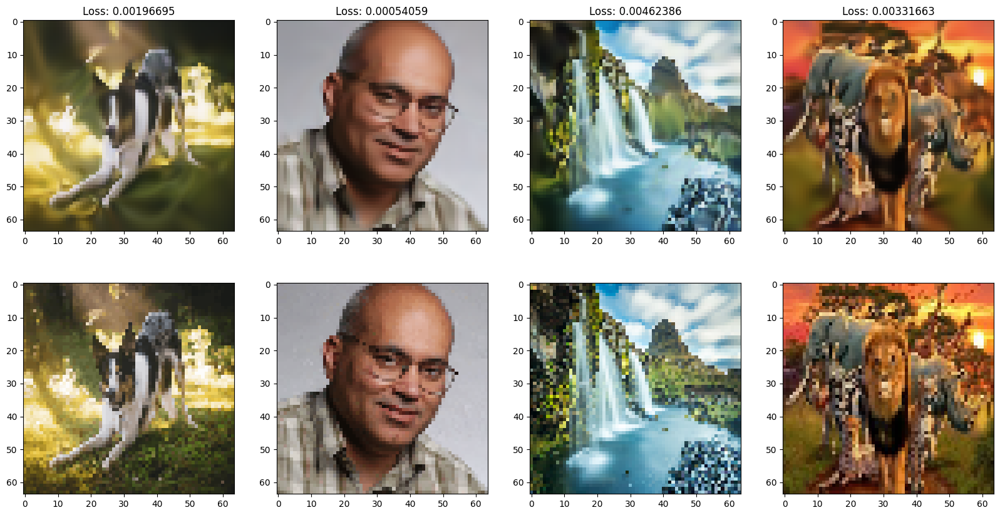

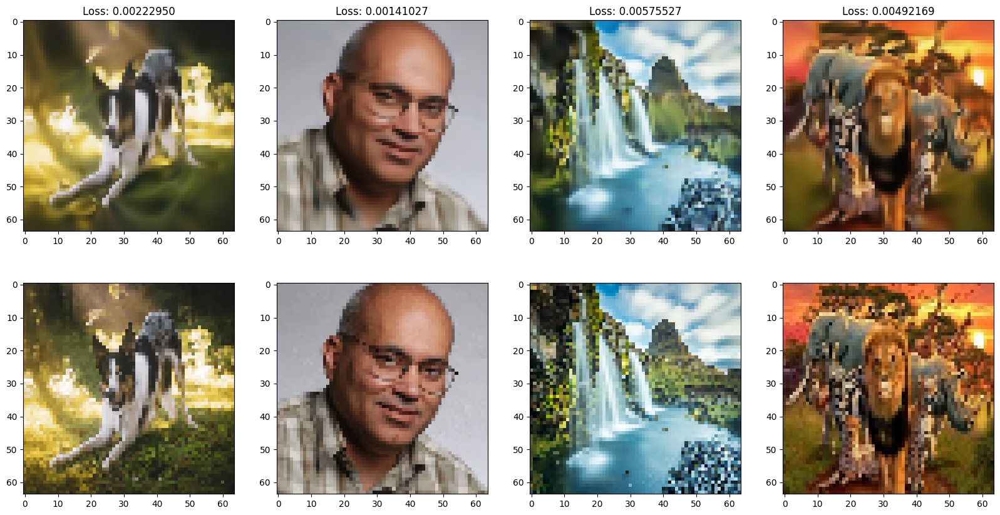

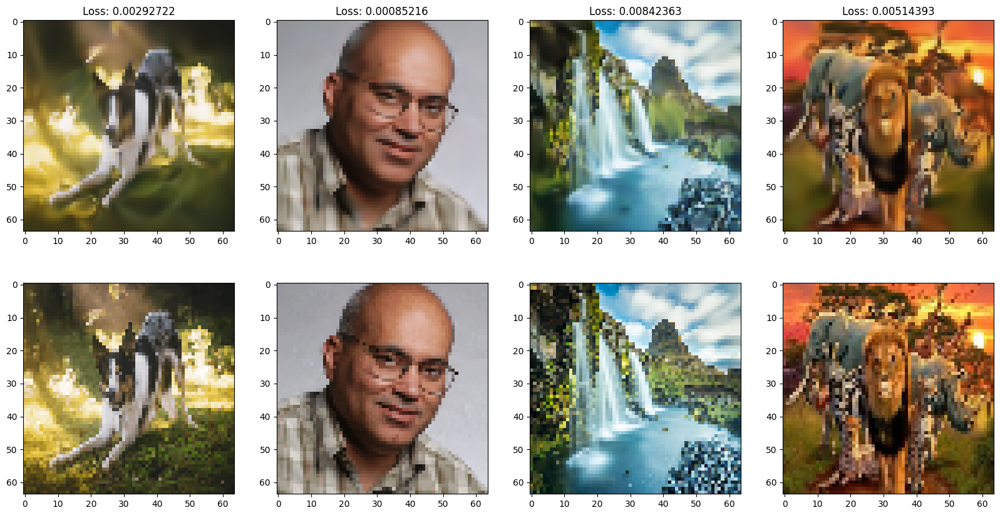

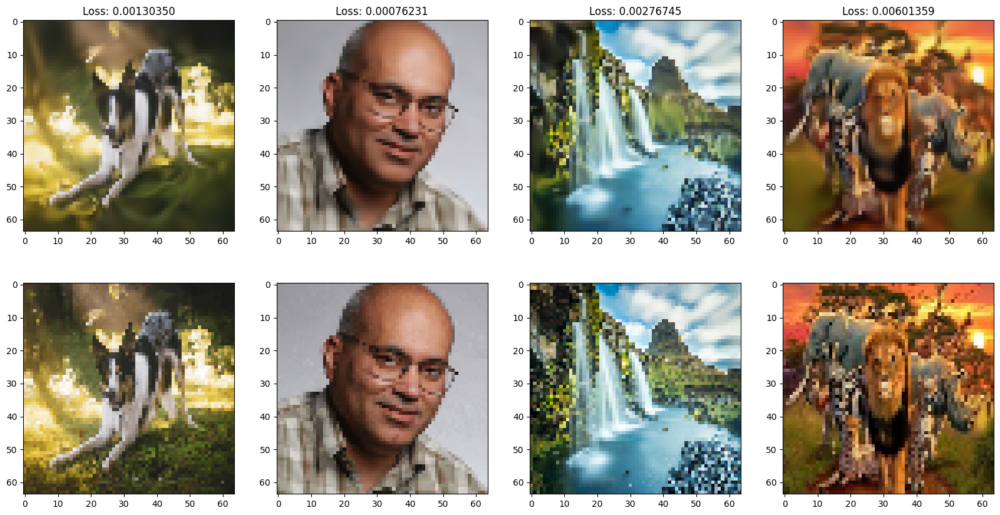

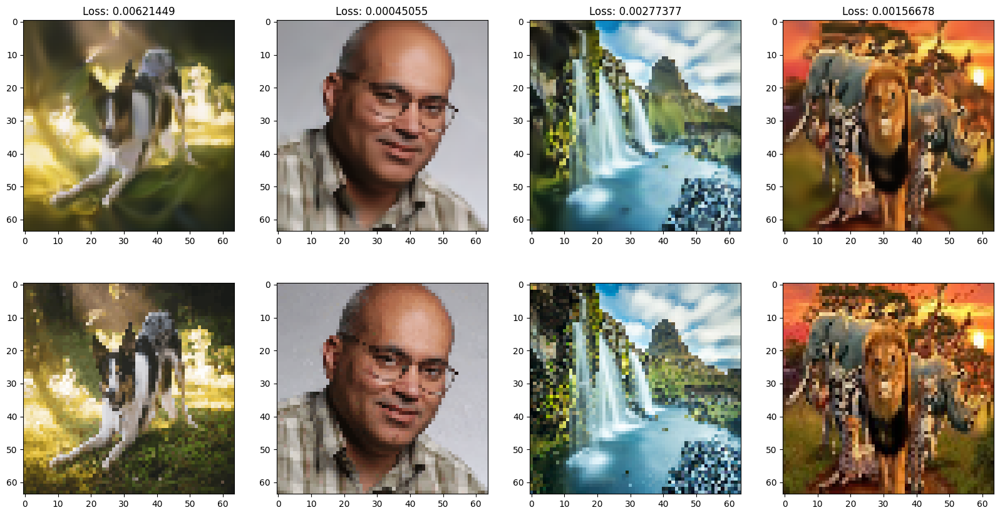

In [137]:
torch.manual_seed(3)
device = 'cuda:0'

img_size = (64, 64)
trans_load = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize(img_size),
])

imgs = ['imgs/dog.png', 'imgs/malik.jpg', 'imgs/waterfall.jpg', 'imgs/animals.jpg']
targets = torch.stack([trans_load(plt.imread(img)[..., :3]) for img in imgs])
print(targets.shape)

dofs = ImageCPPN(n_batches=len(targets), **cppn_params)
# dofs = PixelDOFs(n_batches=len(targets), img_size=img_size)

dofs, targets = dofs.to(device), targets.to(device)
opt = torch.optim.Adam(dofs.parameters(), lr=1e-3)

for i_iteration in tqdm(range(800)):
    imgs = dofs.generate_image(img_size)
    
    loss = (imgs-targets).pow(2.).mean(dim=(-1, -2, -3))
    
    opt.zero_grad()
    loss.mean().backward()
    opt.step()
    
    if i_iteration%50==0:
        plt.figure(figsize=(len(imgs)*5, 2*5))
        for i_img, (l, x, y) in enumerate(zip(loss.tolist(), imgs, targets)):
            plt.subplot(2, len(imgs), i_img+1); plt.imshow(to_np(x.permute(1, 2, 0)))
            plt.title(f'Loss: {l:10.8f}')
            plt.subplot(2, len(imgs), i_img+1+len(imgs)); plt.imshow(to_np(y.permute(1, 2, 0)))
        plt.show()
        # plt.plot([layer.weight.grad.abs().mean().item() for layer in cppn.layers])
        # plt.show()

# Super sampling CPPN at inference time

torch.Size([4, 3, 320, 320])


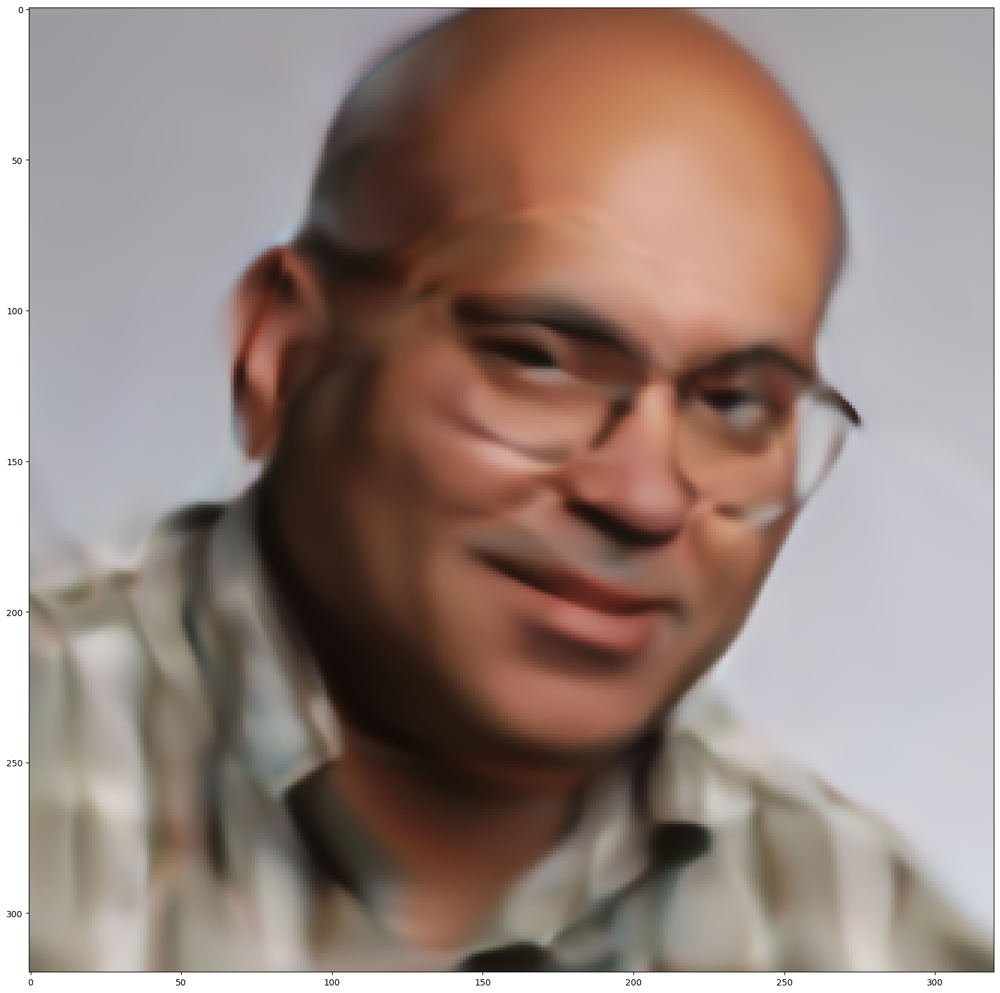

In [140]:
with torch.no_grad():
    a = dofs.generate_image((64*5, 64*5))
print(a.shape)
plt.figure(figsize=(20, 20))
plt.imshow(to_np(a[1].permute(1, 2, 0)))

# Optimizing CLIP Objective with Pixels

In [6]:
import clip
import lpips

net_clip, preprocess = clip.load("RN50", device=device)
net_lpips = lpips.LPIPS(net='alex').to(device)

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/afs/csail.mit.edu/u/a/akumar01/miniconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/afs/csail.mit.edu/u/a/akumar01/miniconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /afs/csail.mit.edu/u/a/akumar01/miniconda3/lib/python3.9/site-packages/lpips/weights/v0.1/alex.pth


In [7]:
import optimization

In [8]:
preprocess

Compose(
    Resize(size=224, interpolation=bicubic, max_size=None, antialias=None)
    CenterCrop(size=(224, 224))
    <function _convert_image_to_rgb at 0x7f7bb0ae25e0>
    ToTensor()
    Normalize(mean=(0.48145466, 0.4578275, 0.40821073), std=(0.26862954, 0.26130258, 0.27577711))
)

torch.Size([4, 3, 64, 64])


  0%|          | 0/10000 [00:00<?, ?it/s]

-0.003722667694091797


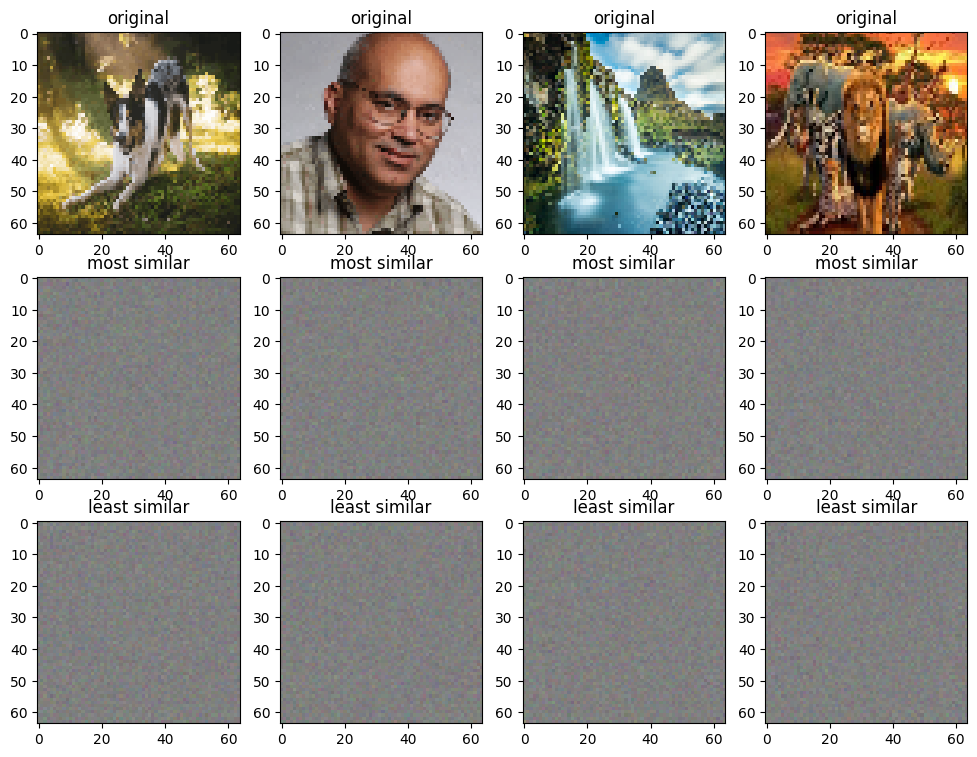

-1.0019807815551758


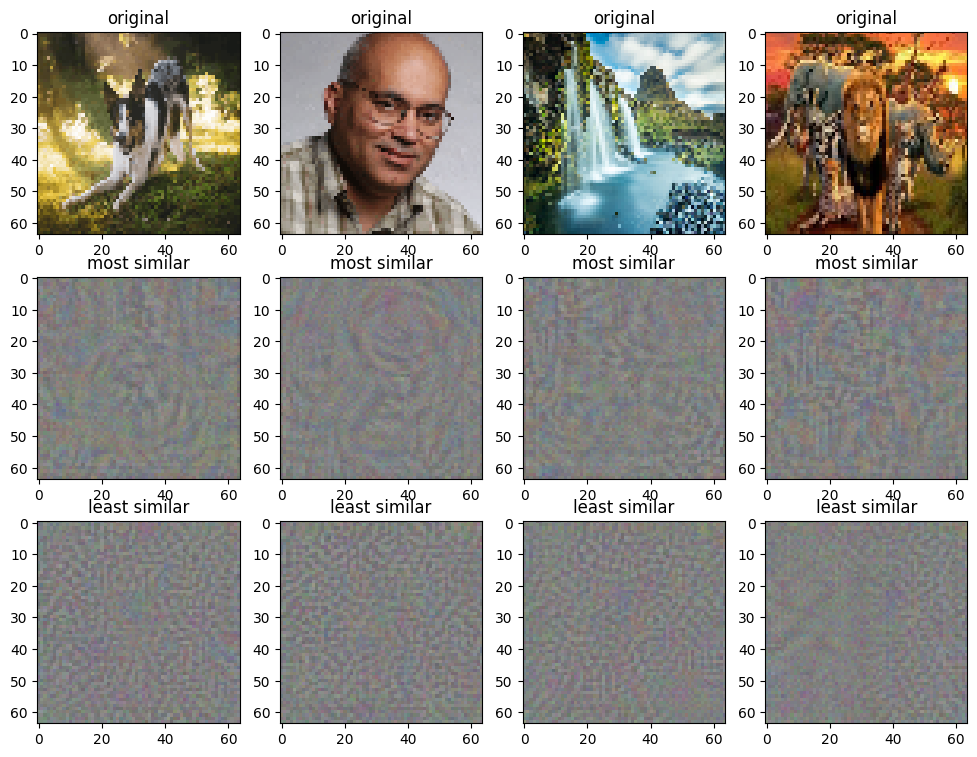

-1.2449394464492798


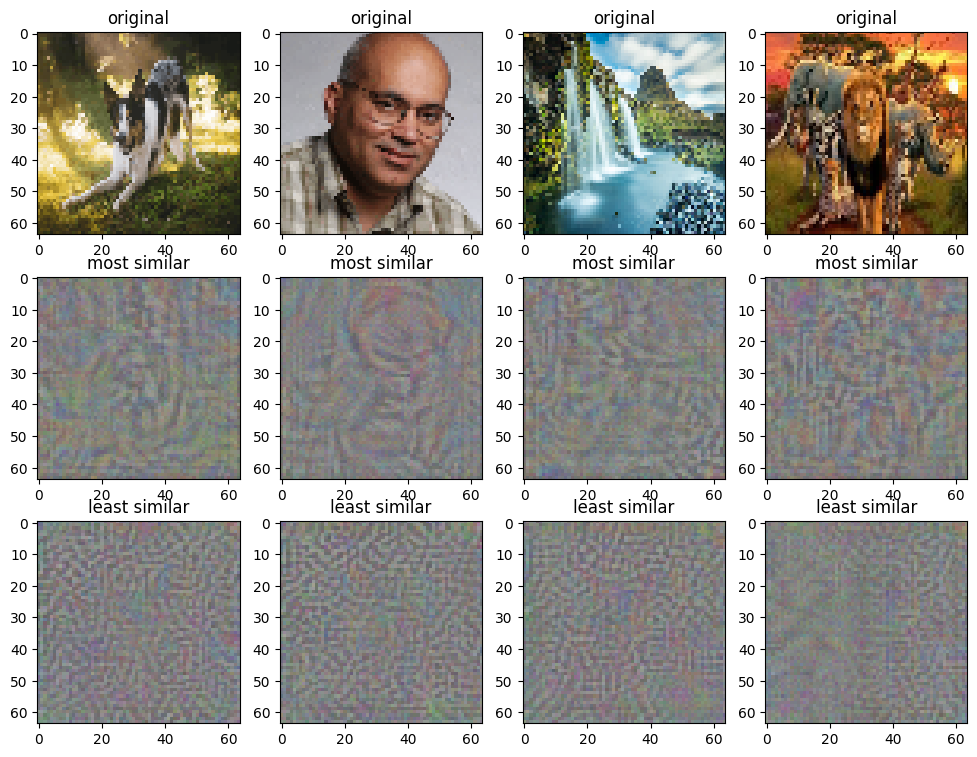

-1.3705782890319824


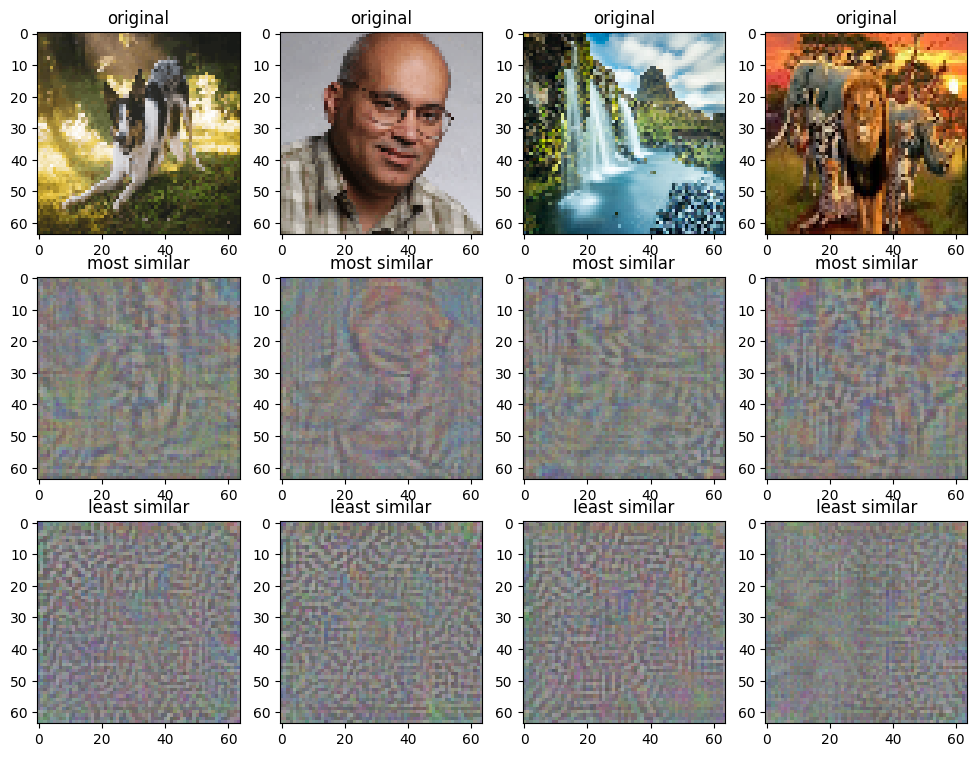

-1.510070562362671


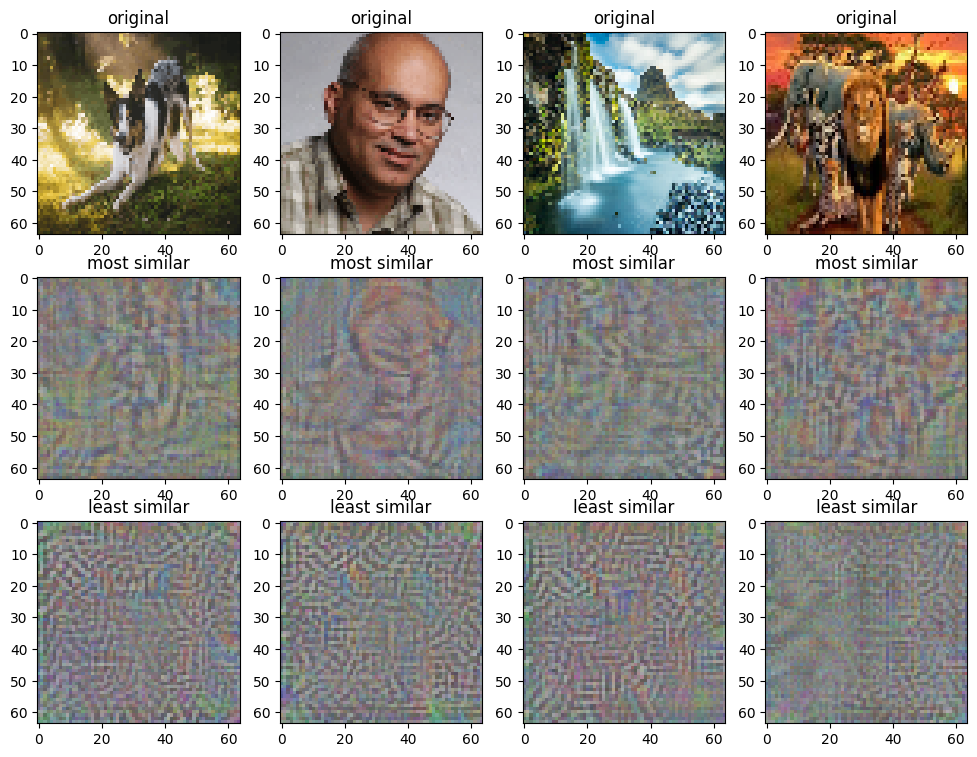

-1.6243075132369995


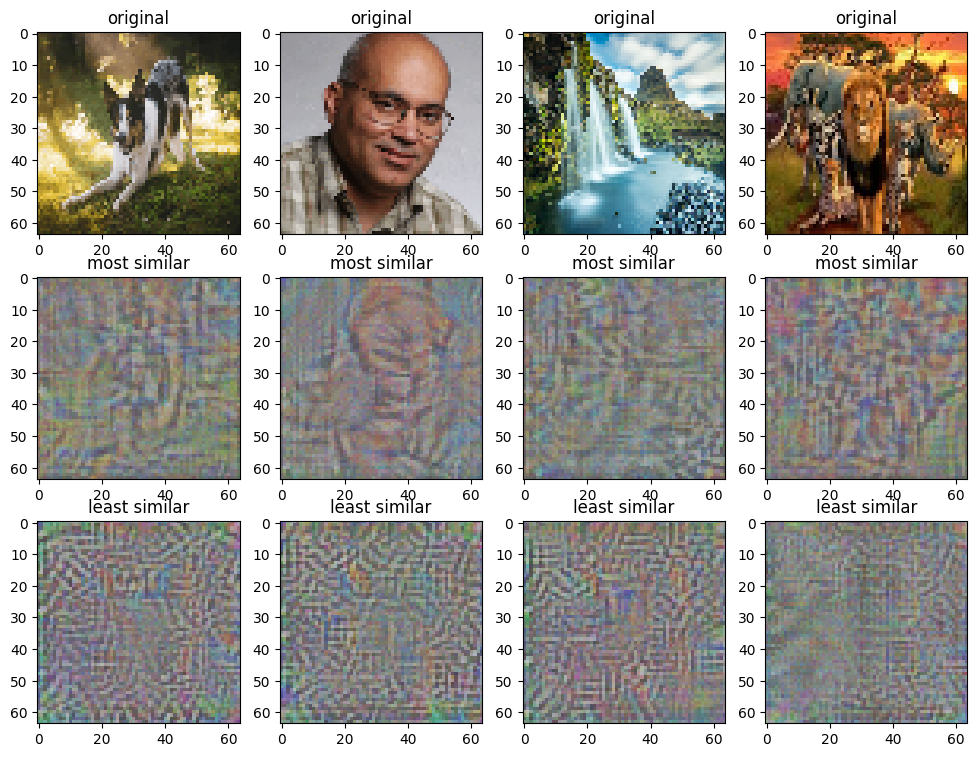

-1.687006950378418


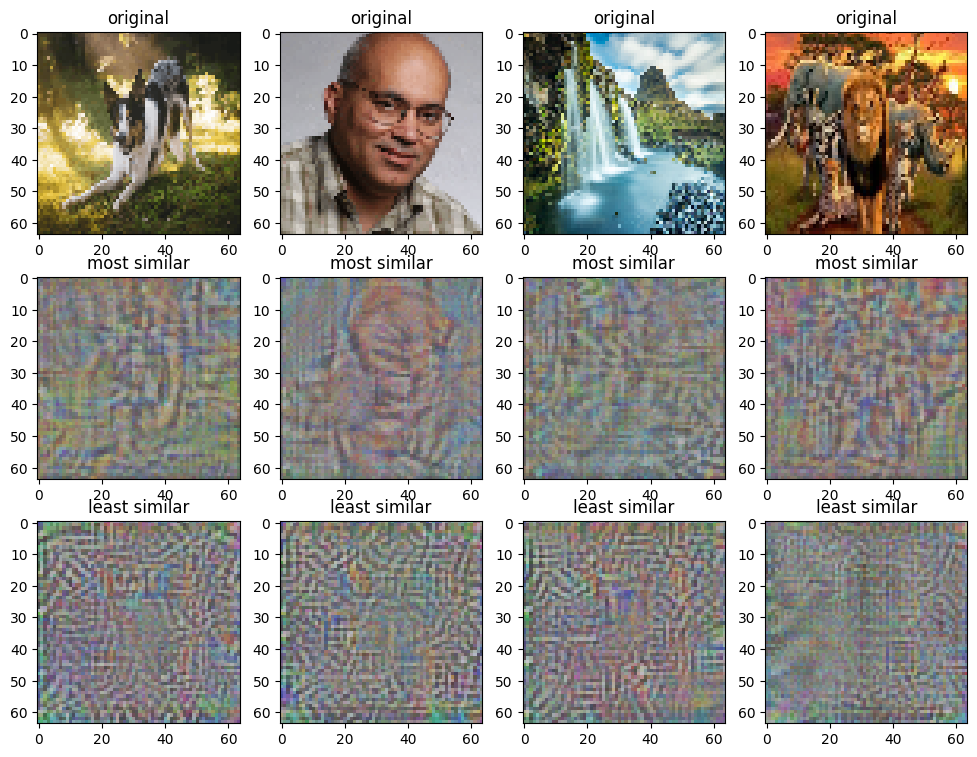

-1.7402269840240479


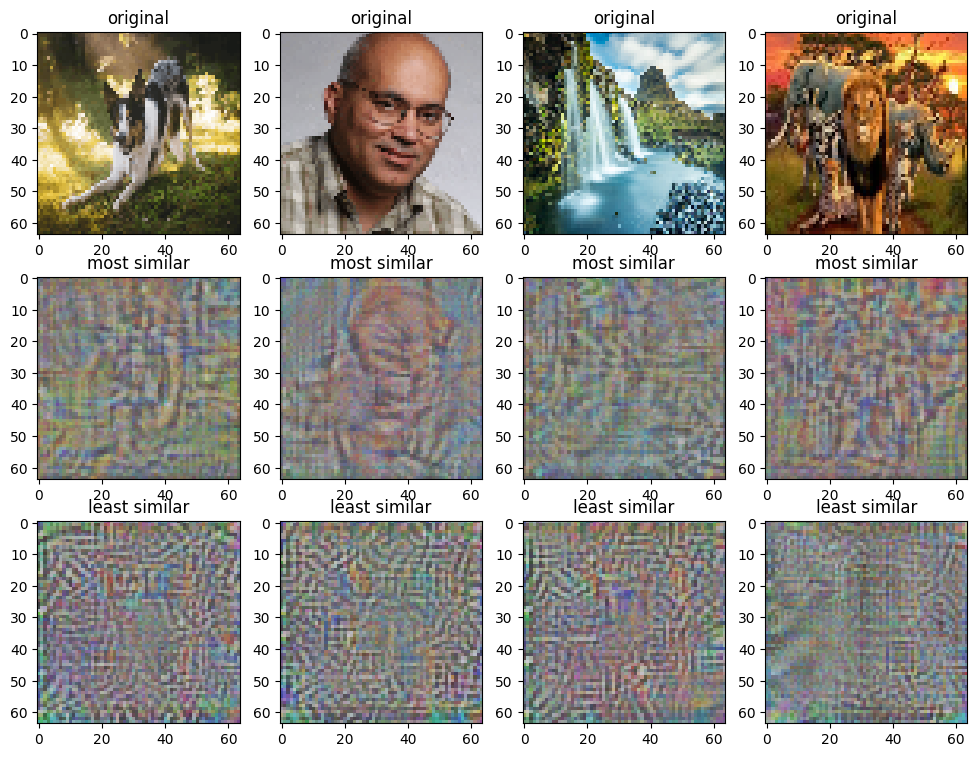

-1.777319312095642


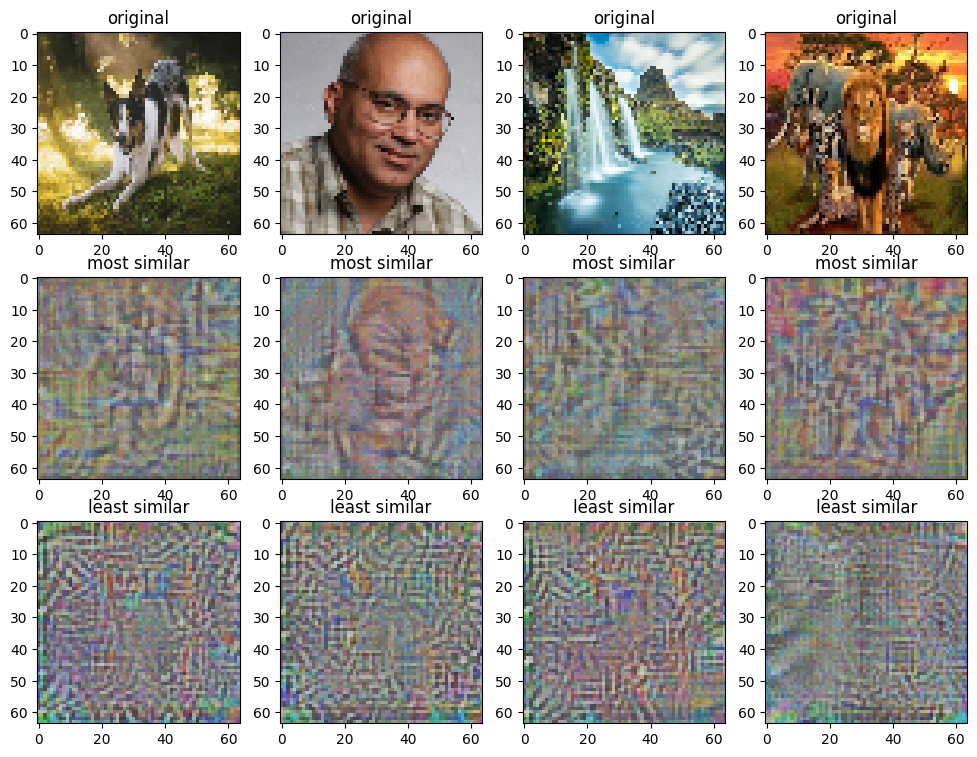

-1.812497854232788


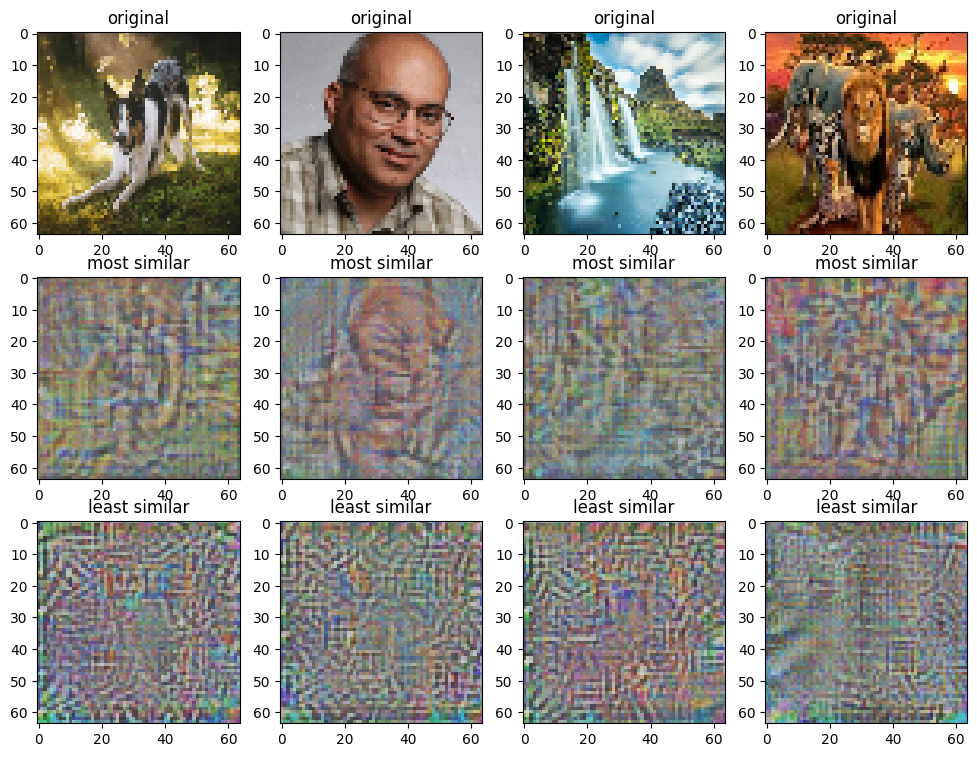

-1.839860439300537


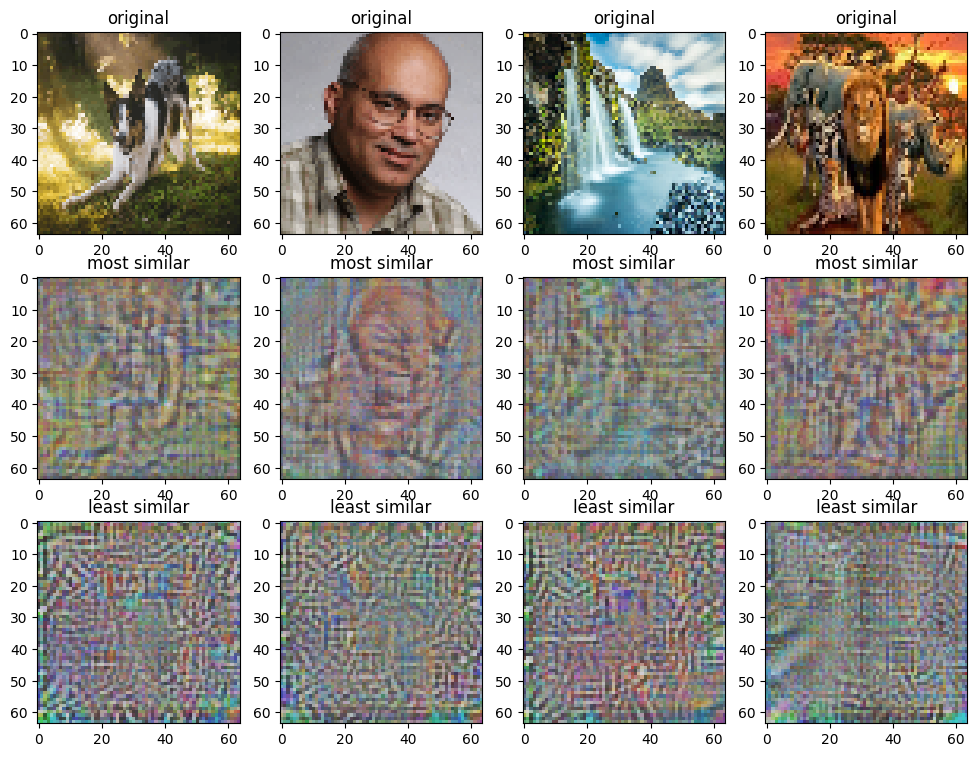

-1.8625415563583374


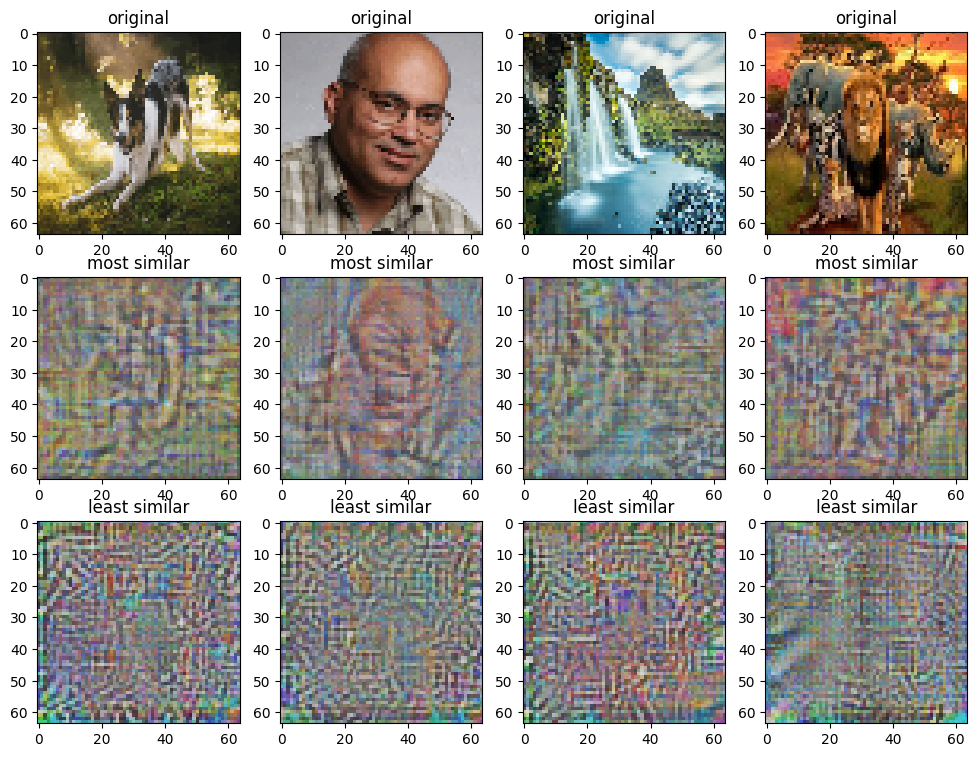

-1.8564493656158447


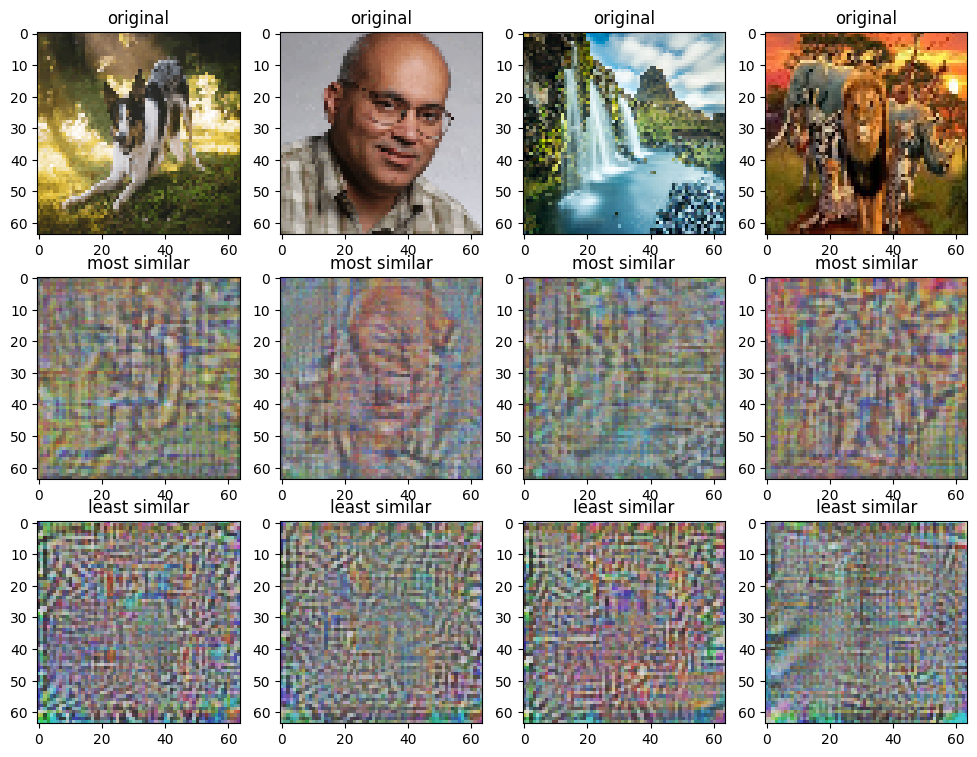

-1.878895878791809


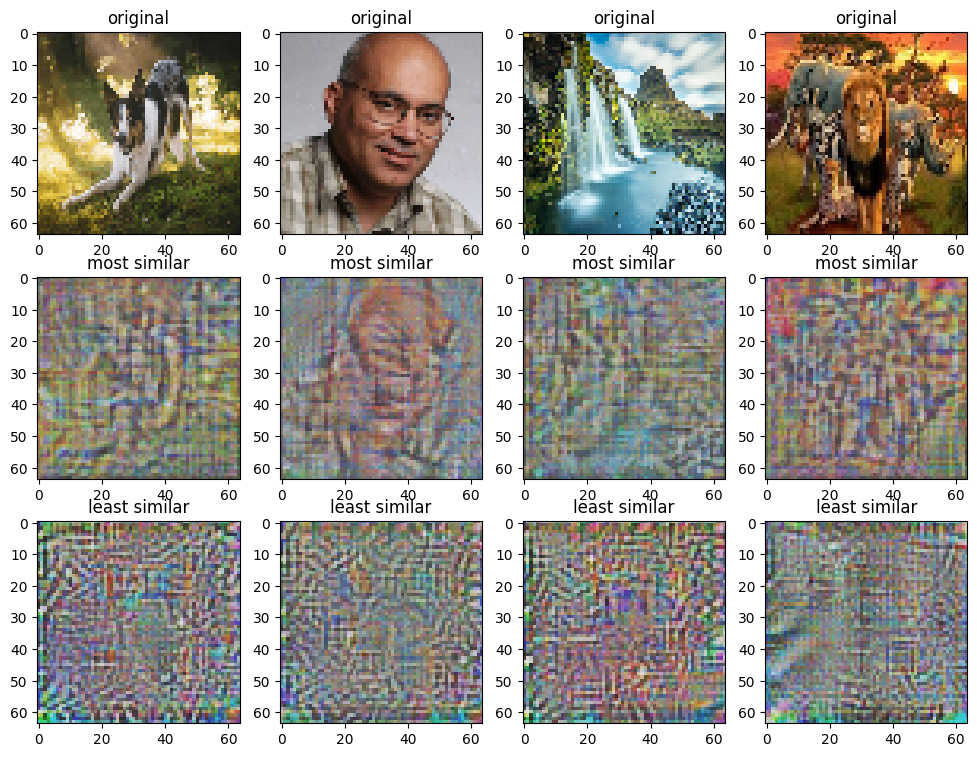

-1.861375093460083


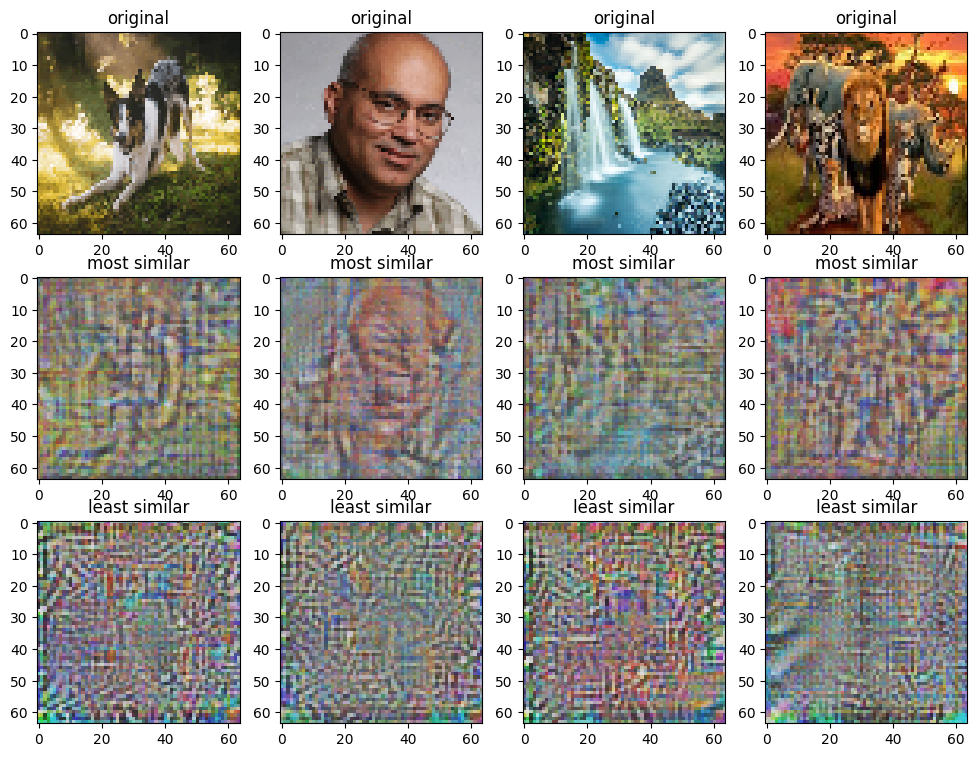

-1.8787254095077515


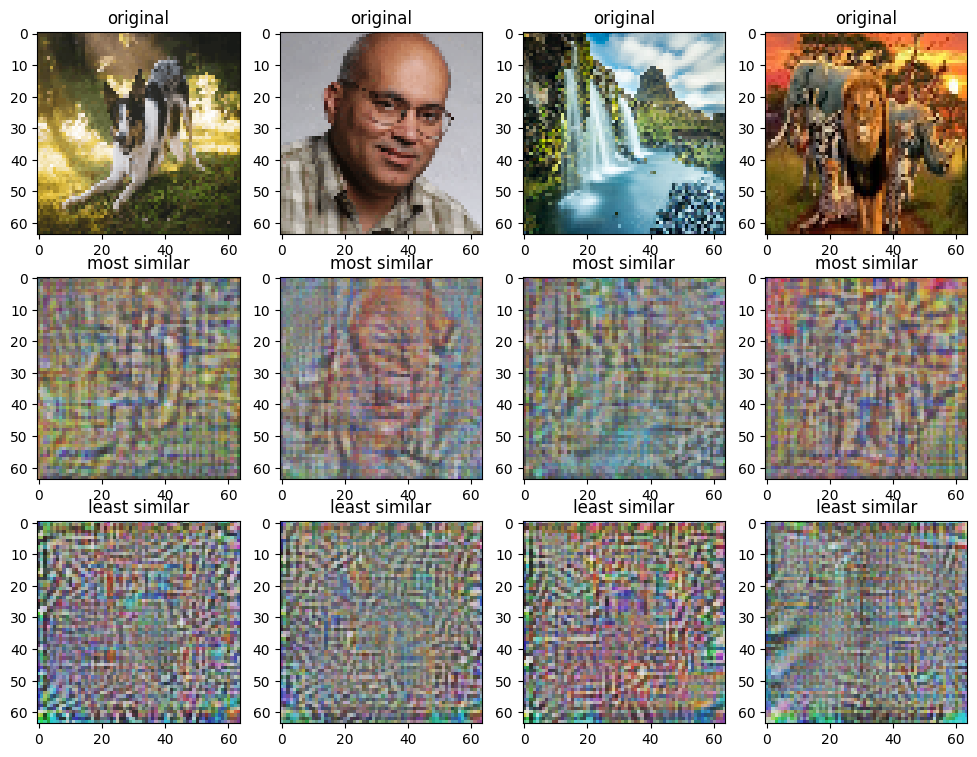

-1.891101598739624


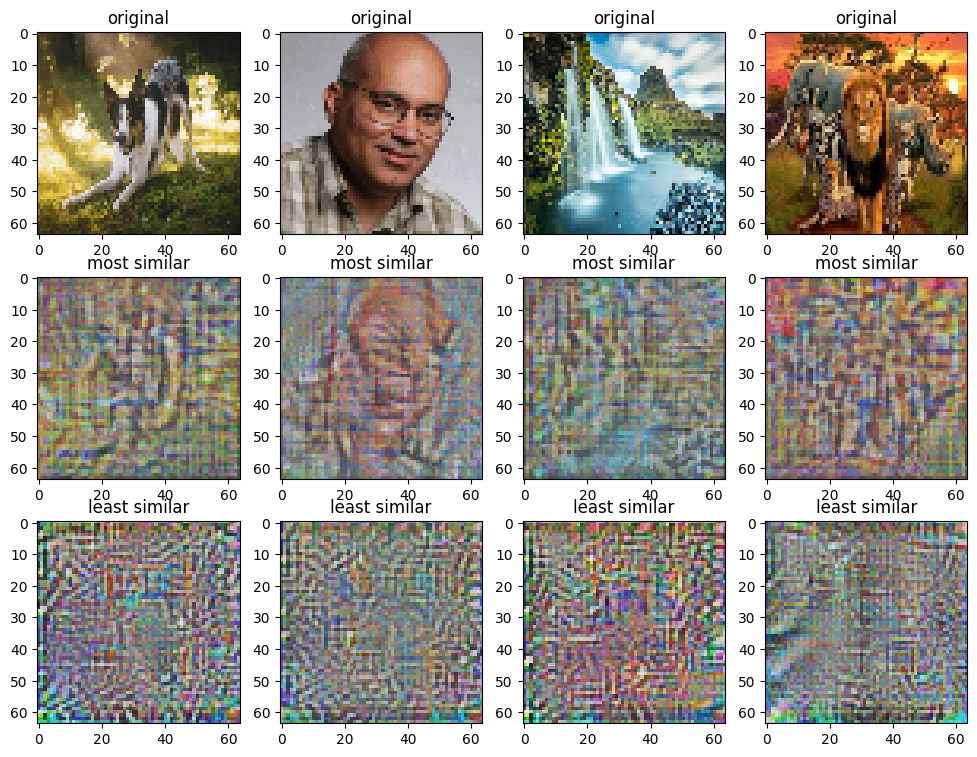

-1.9043915271759033


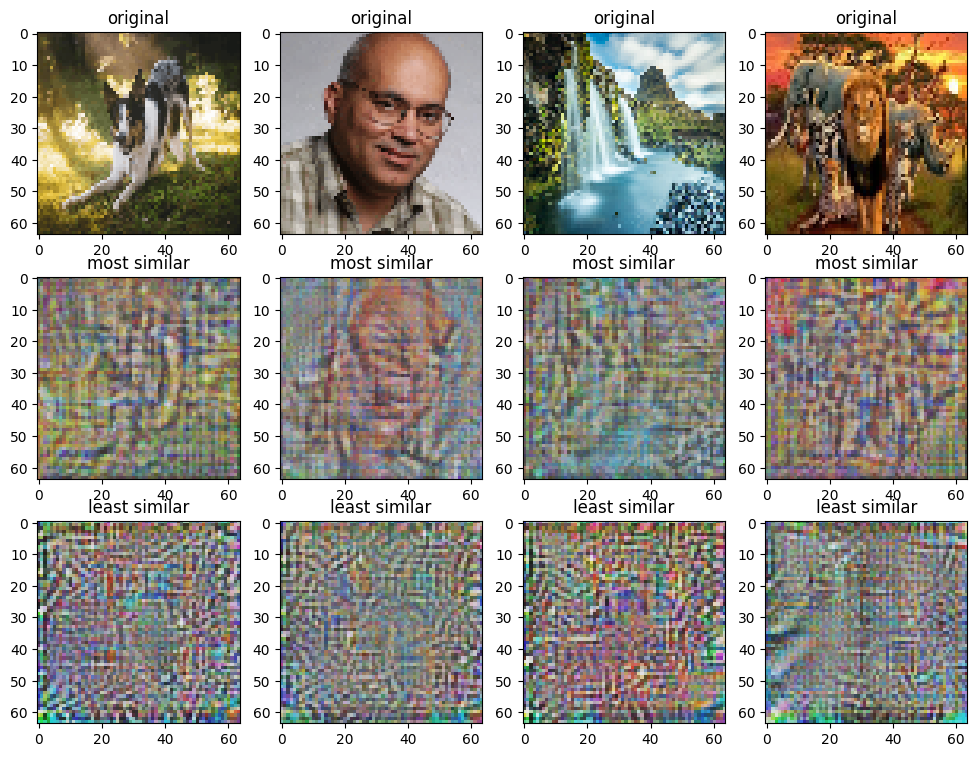

-1.9150481224060059


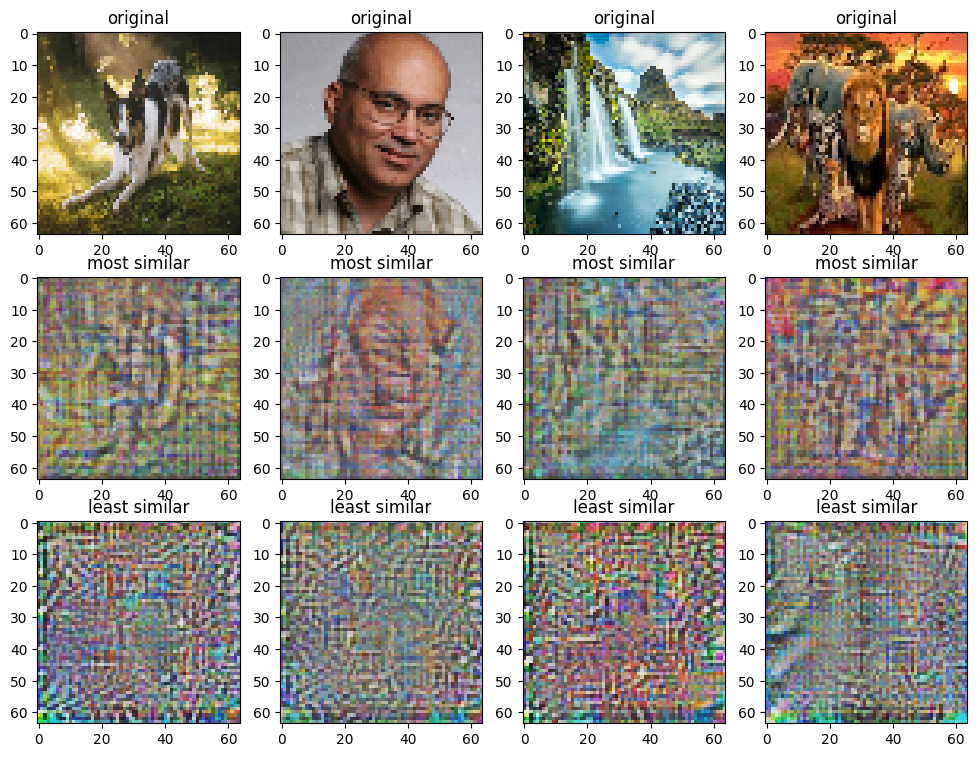

-1.9249916076660156


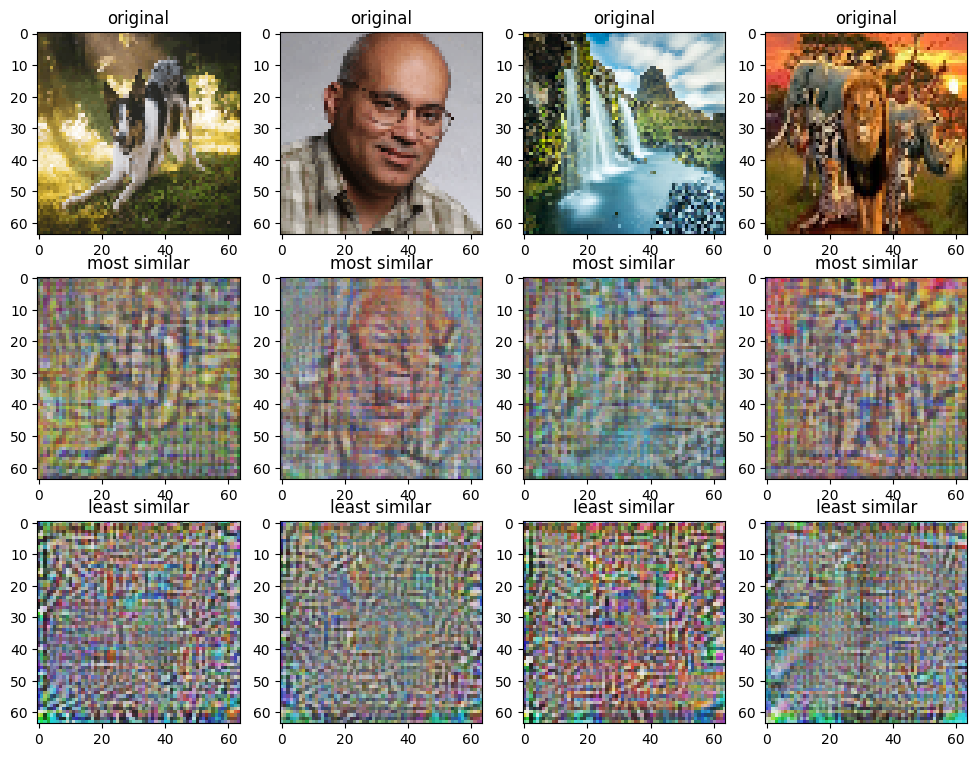

-1.9397248029708862


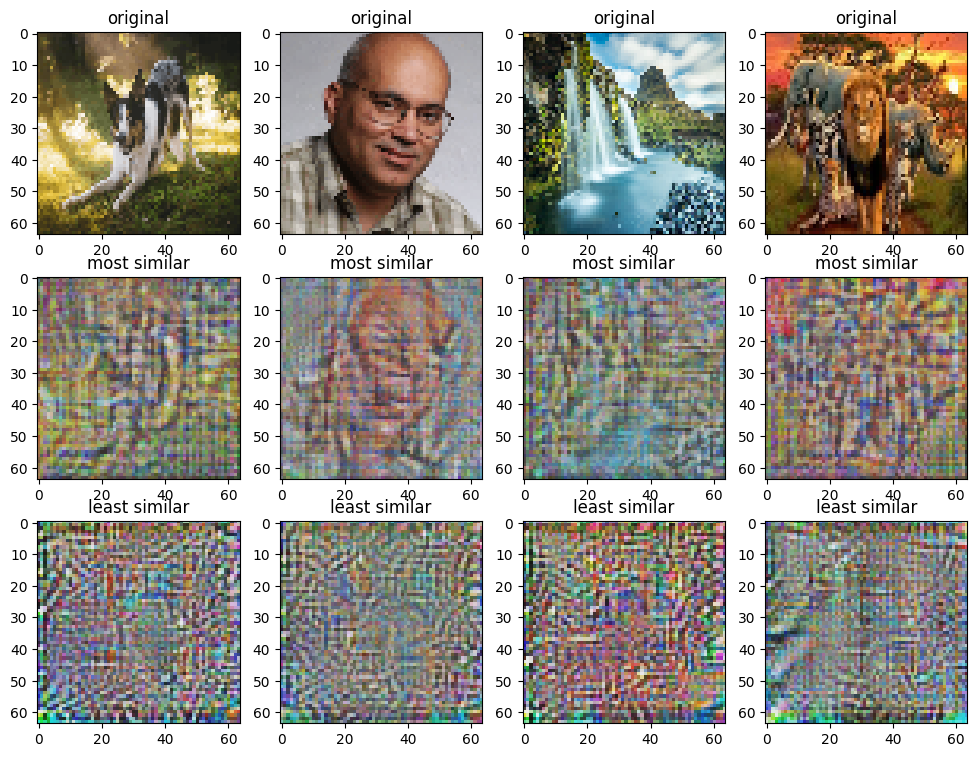

-1.951335072517395


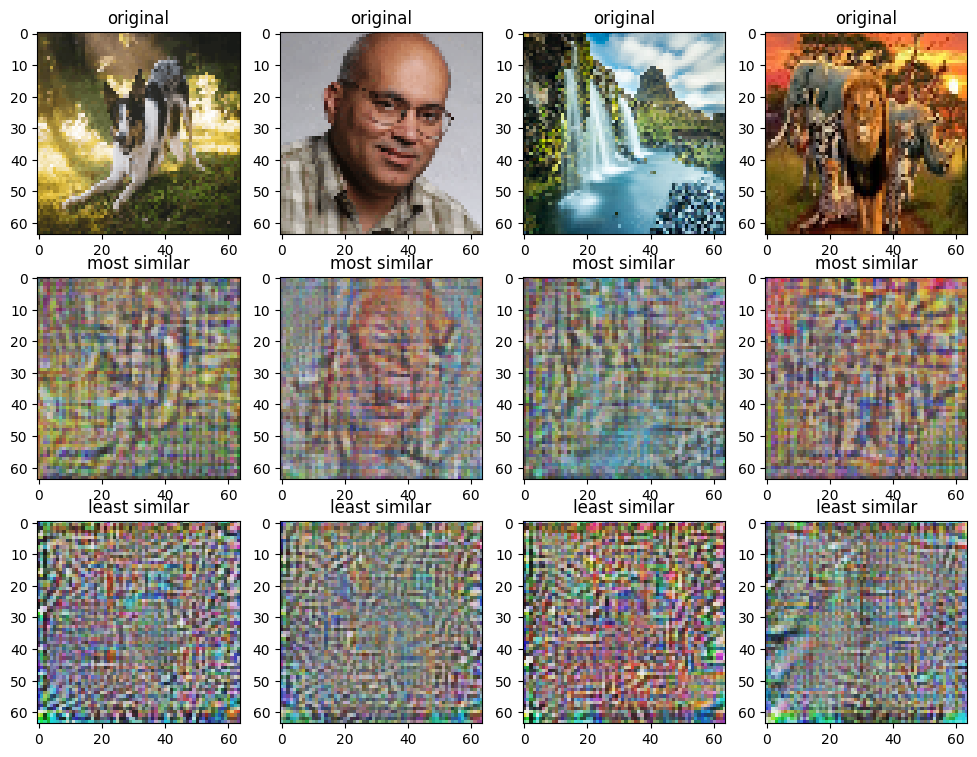

-1.9609448909759521


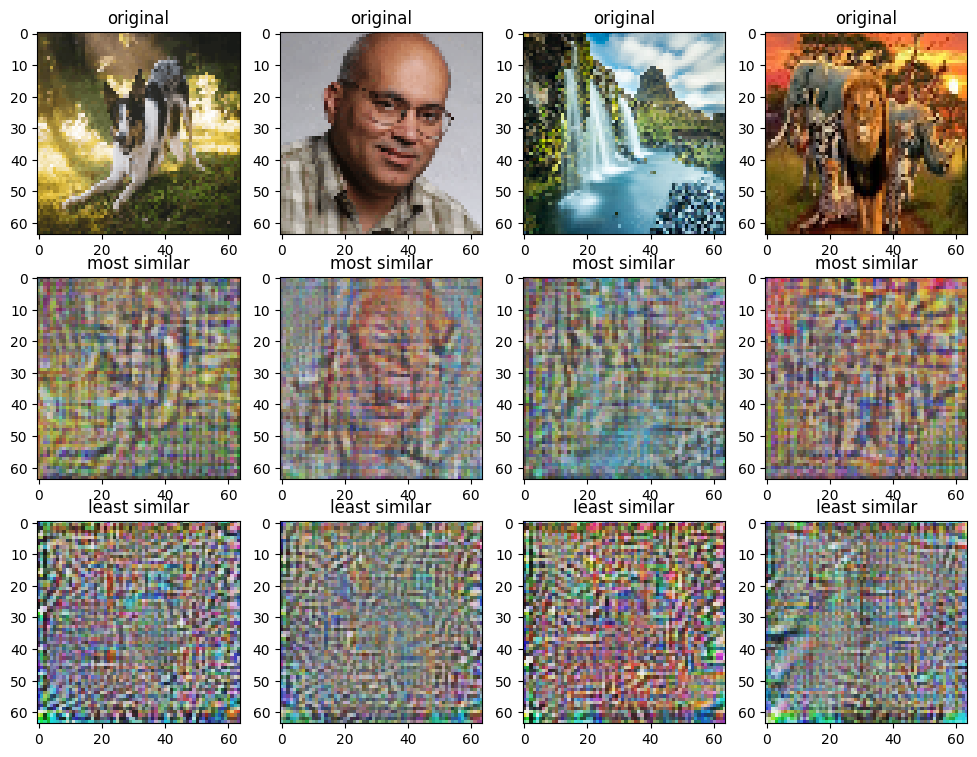

-1.9632372856140137


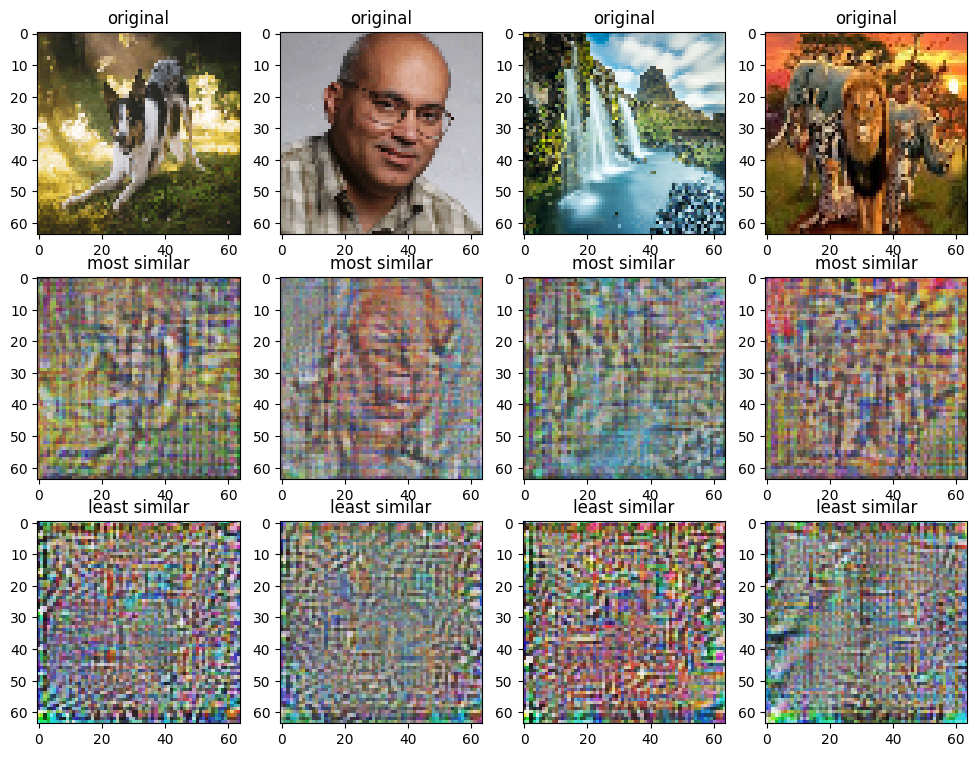

-1.969183087348938


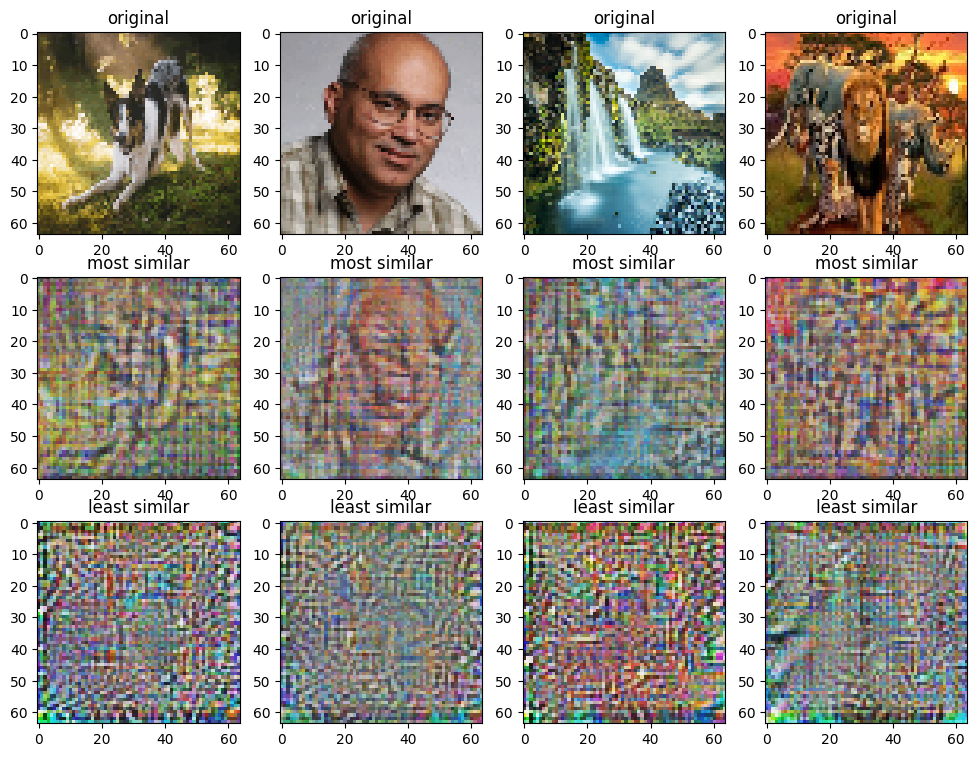

-1.9775699377059937


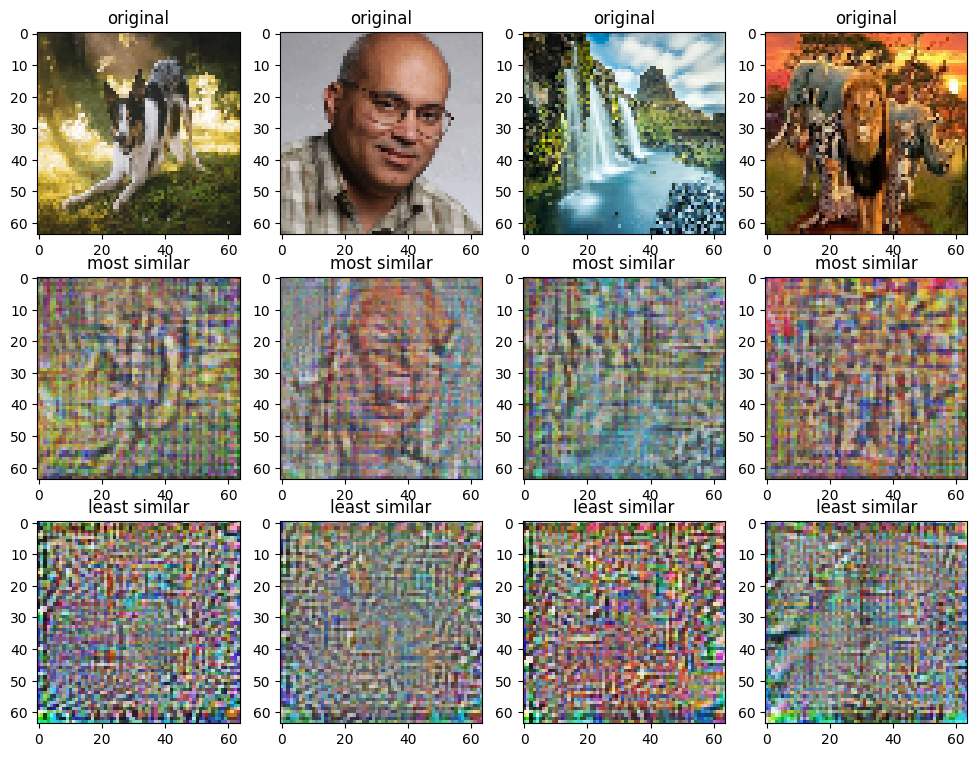

-1.985172986984253


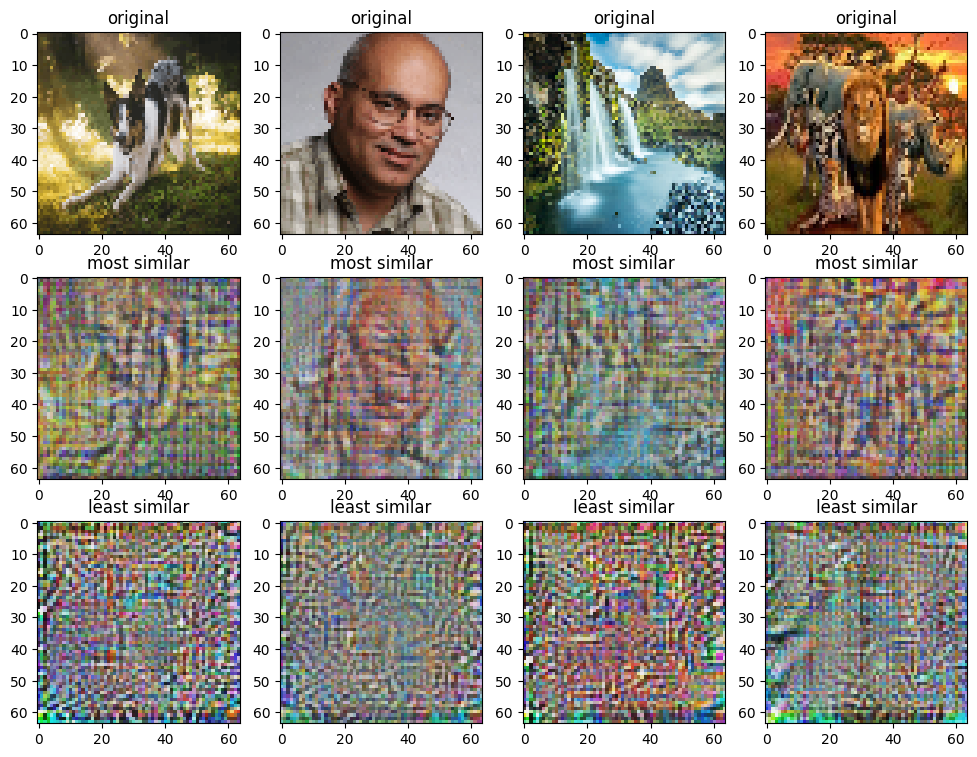

-1.9870553016662598


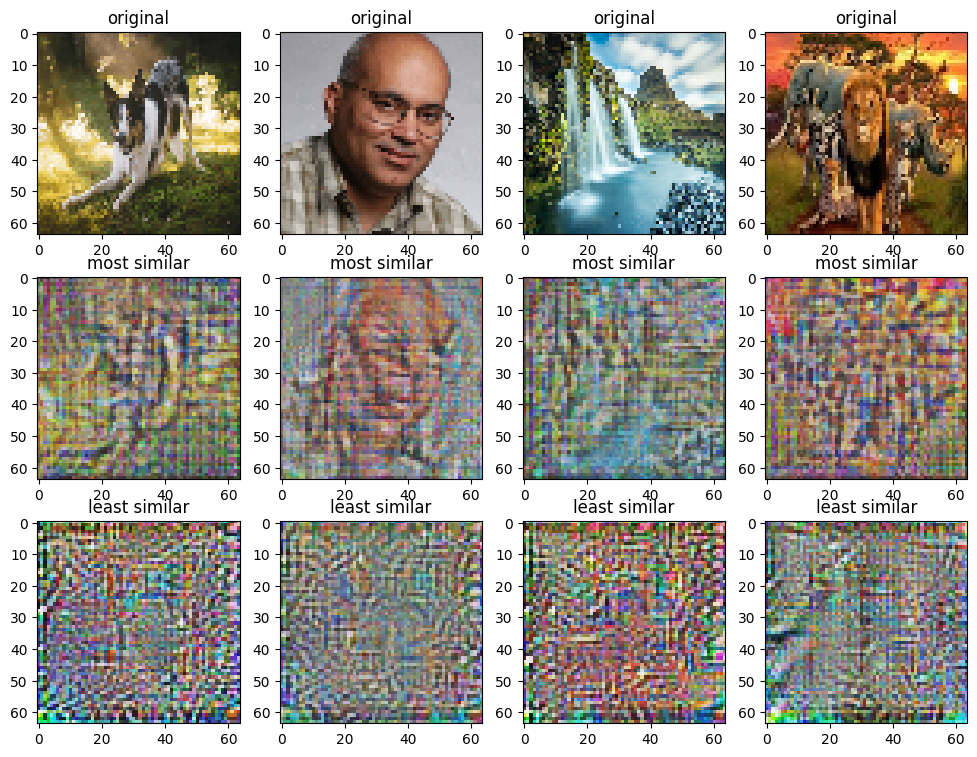

-1.9914299249649048


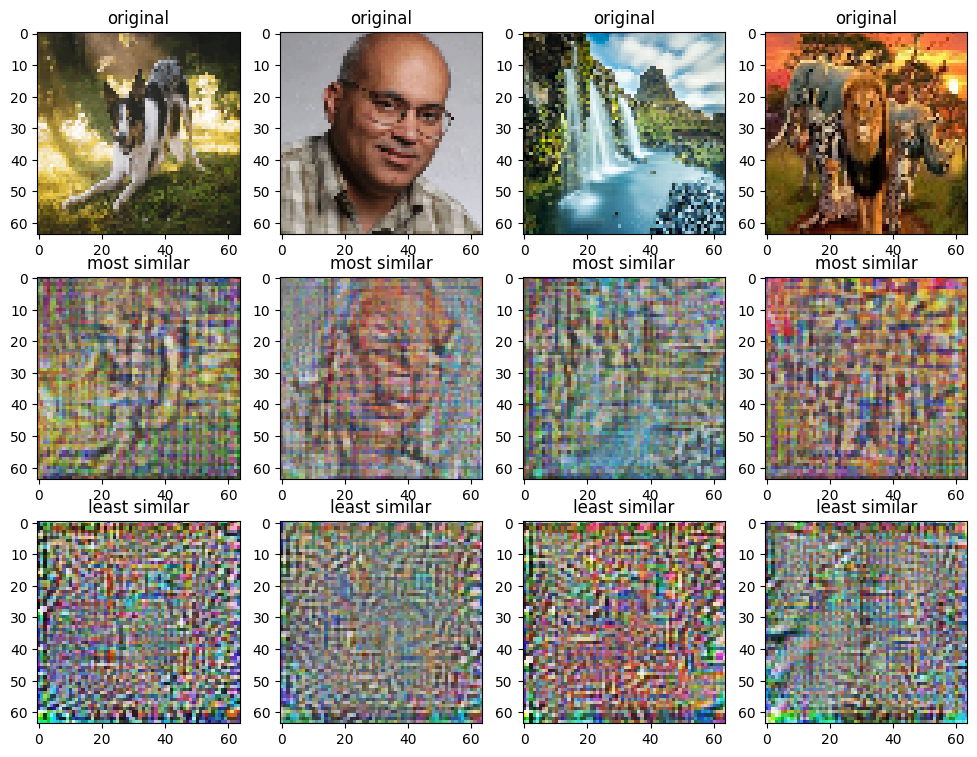

-2.0052671432495117


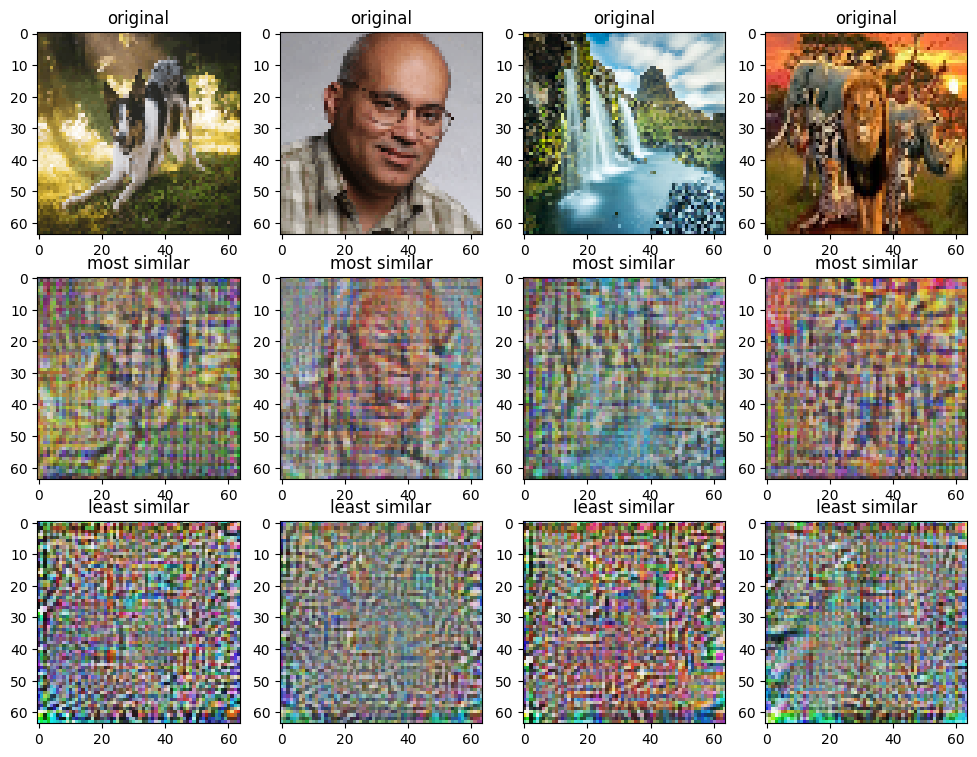

-2.0110487937927246


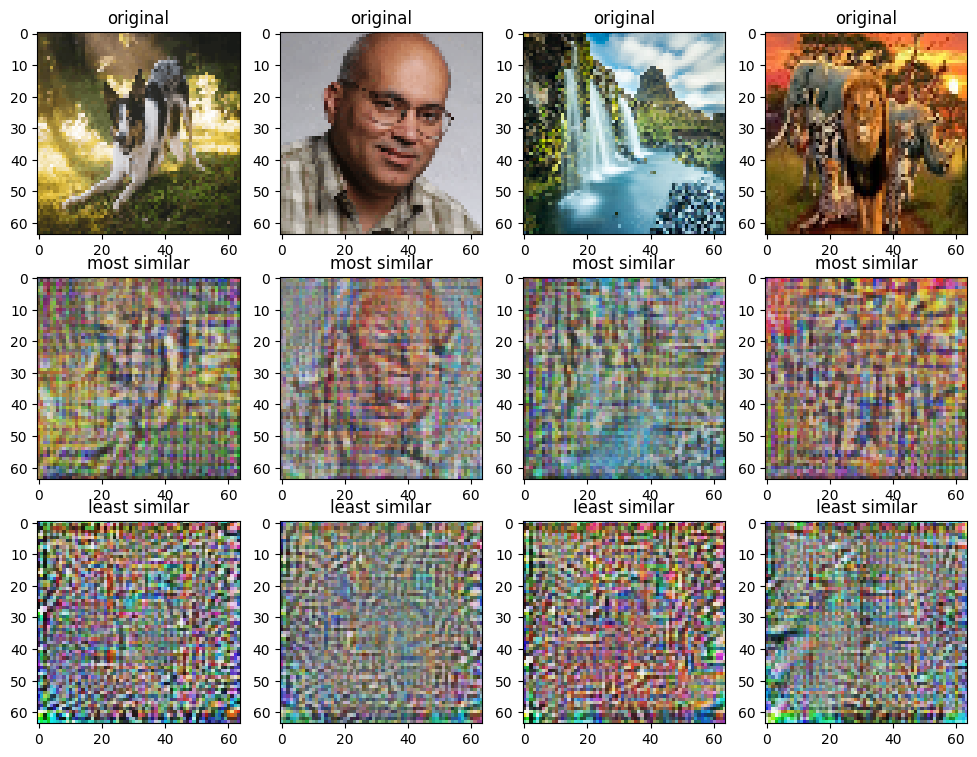

-2.0090298652648926


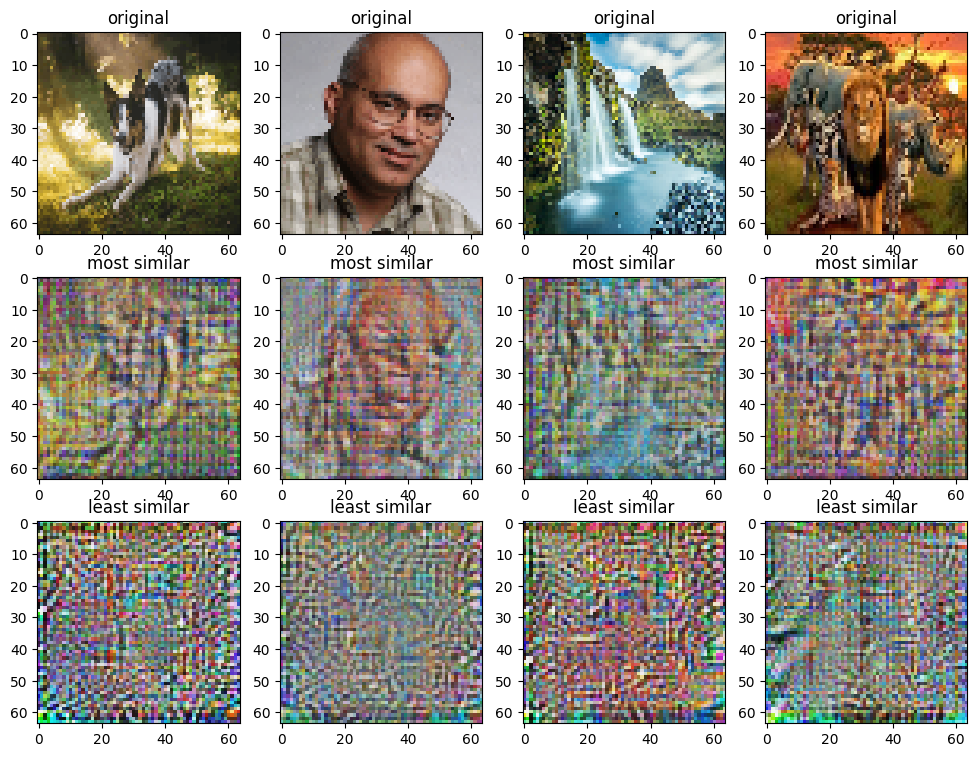

-1.9792428016662598


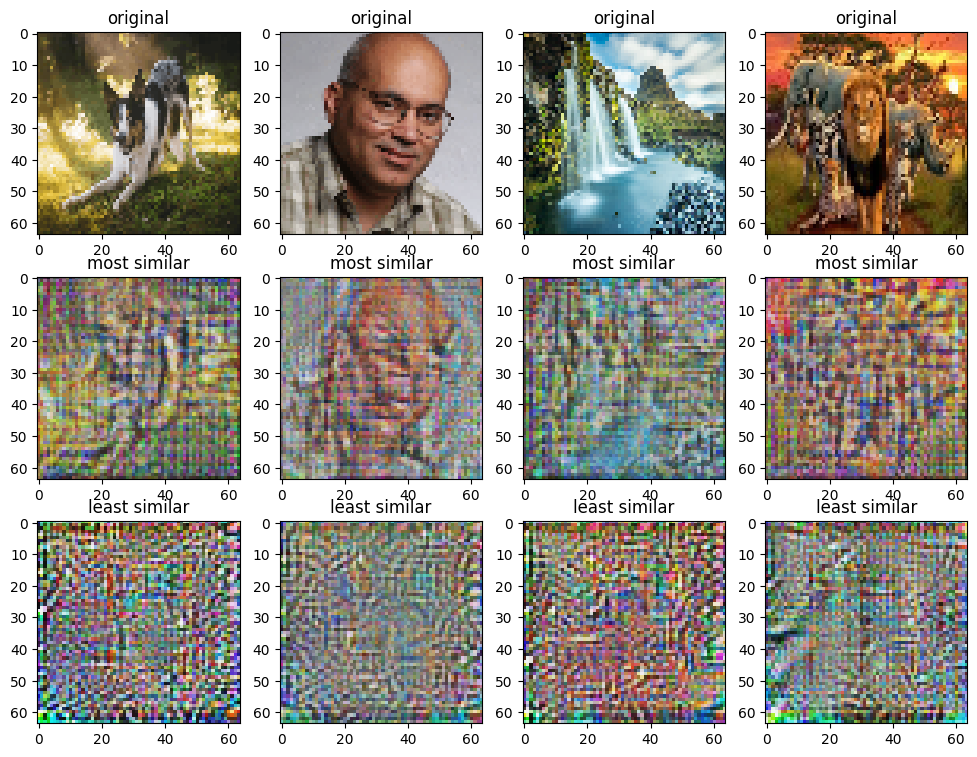

-1.9836746454238892


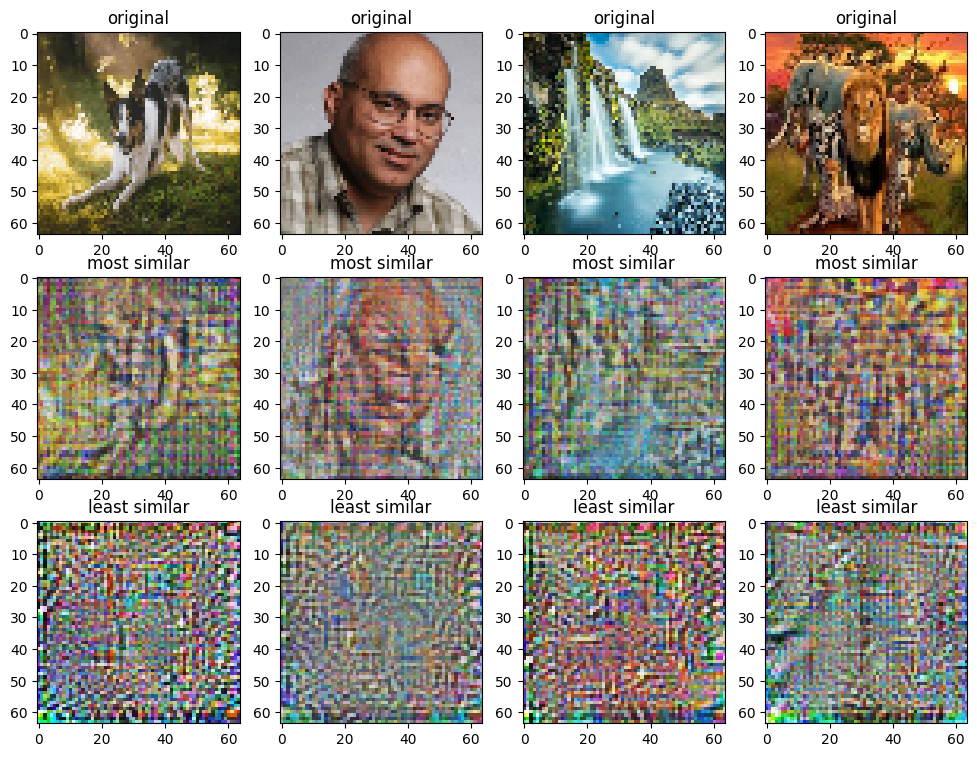

-2.0215795040130615


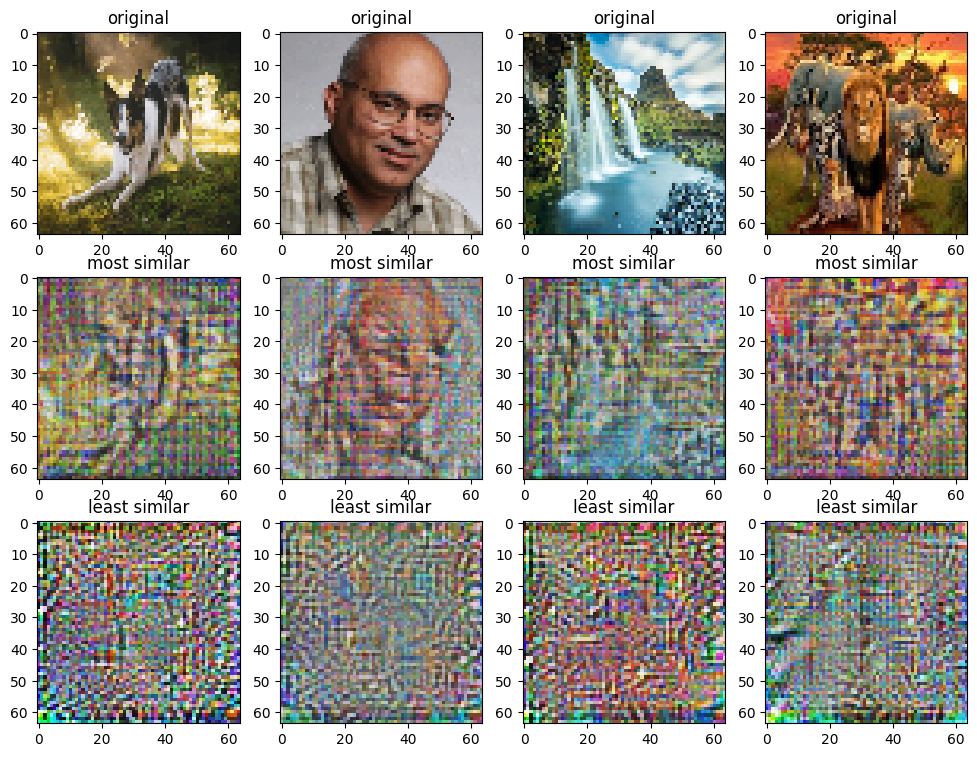

-2.026726484298706


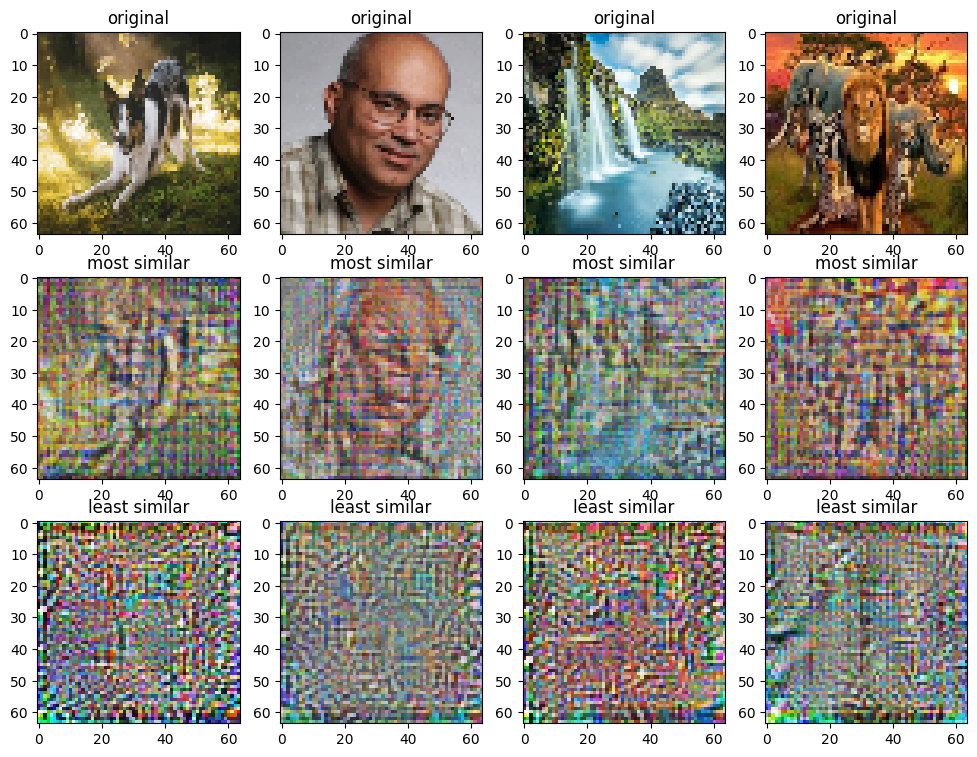

-1.9937059879302979


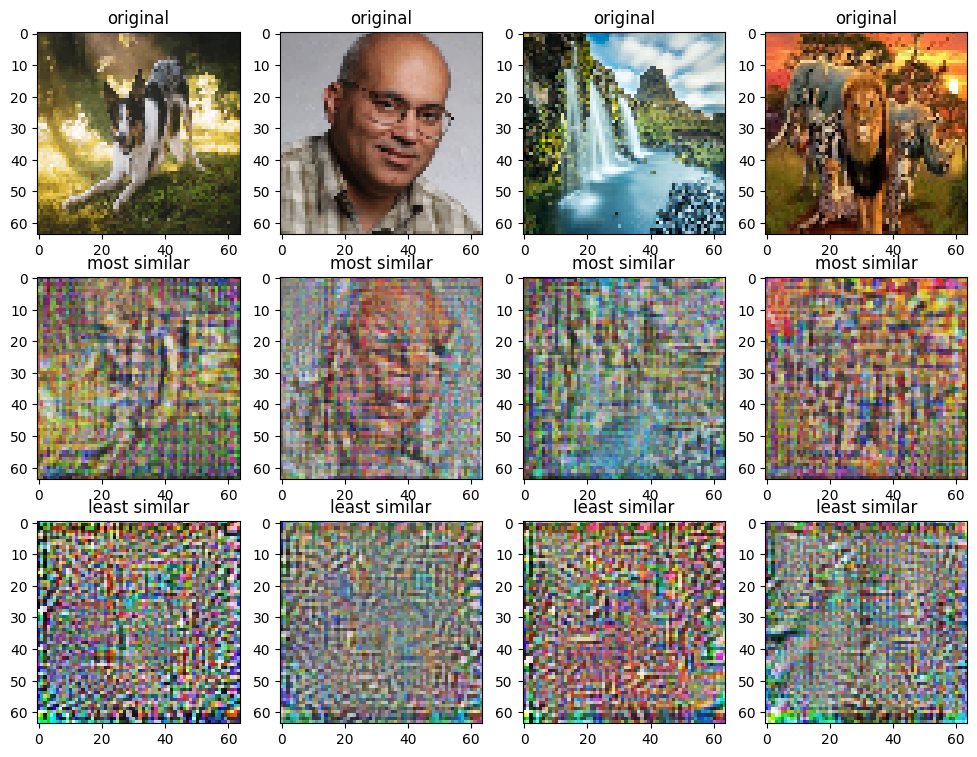

-2.003192901611328


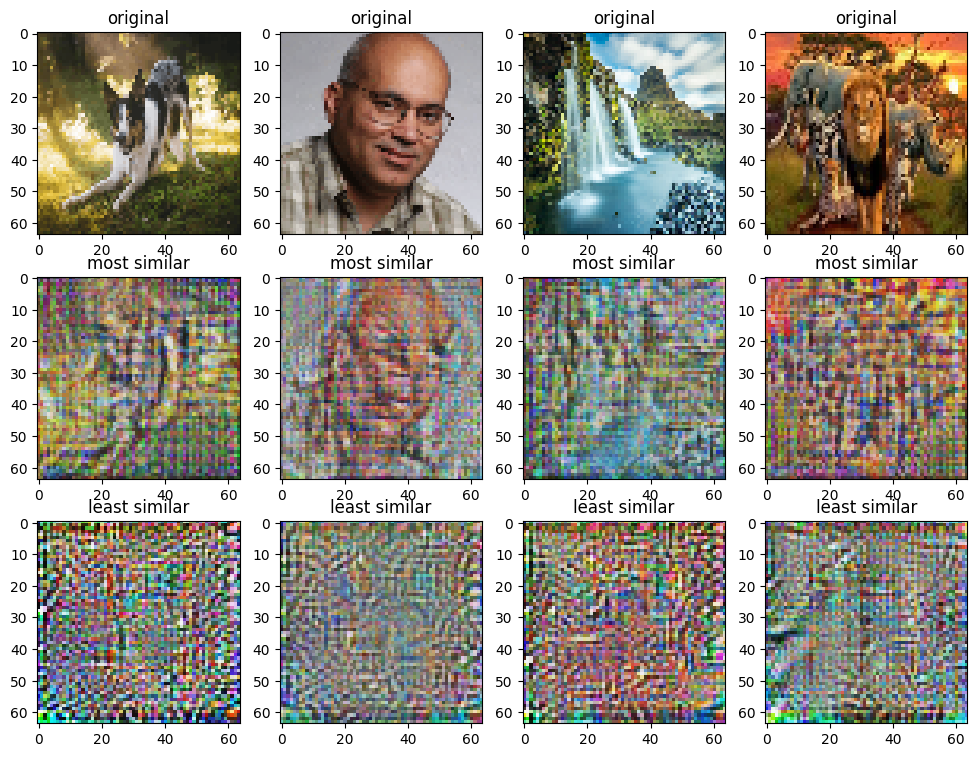

-2.0066847801208496


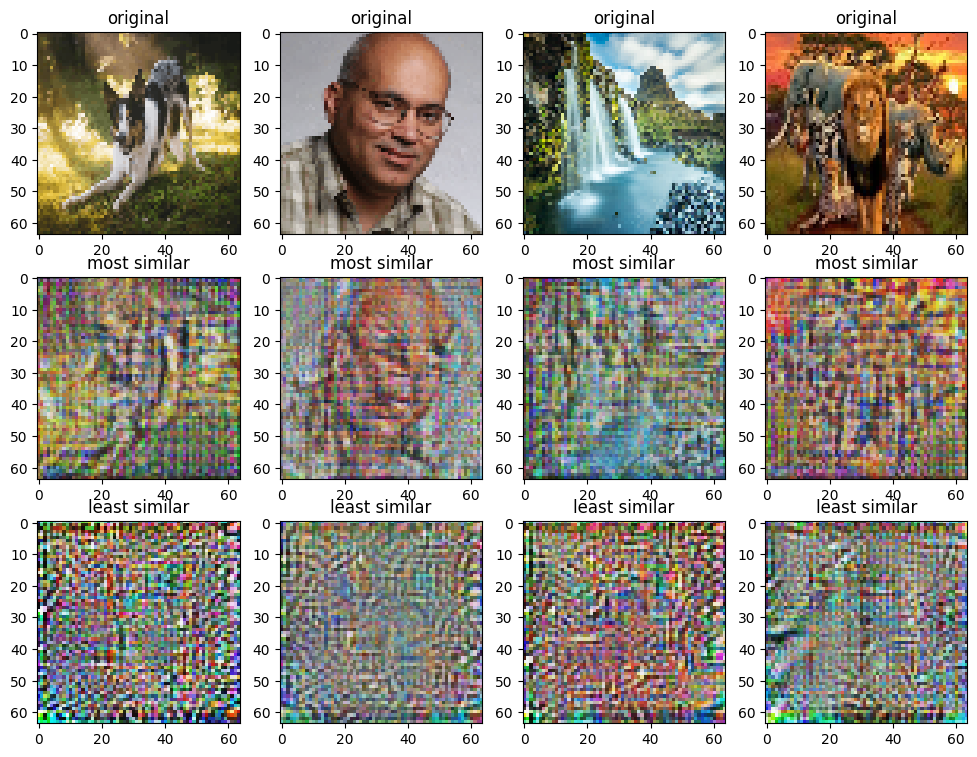

-2.006834030151367


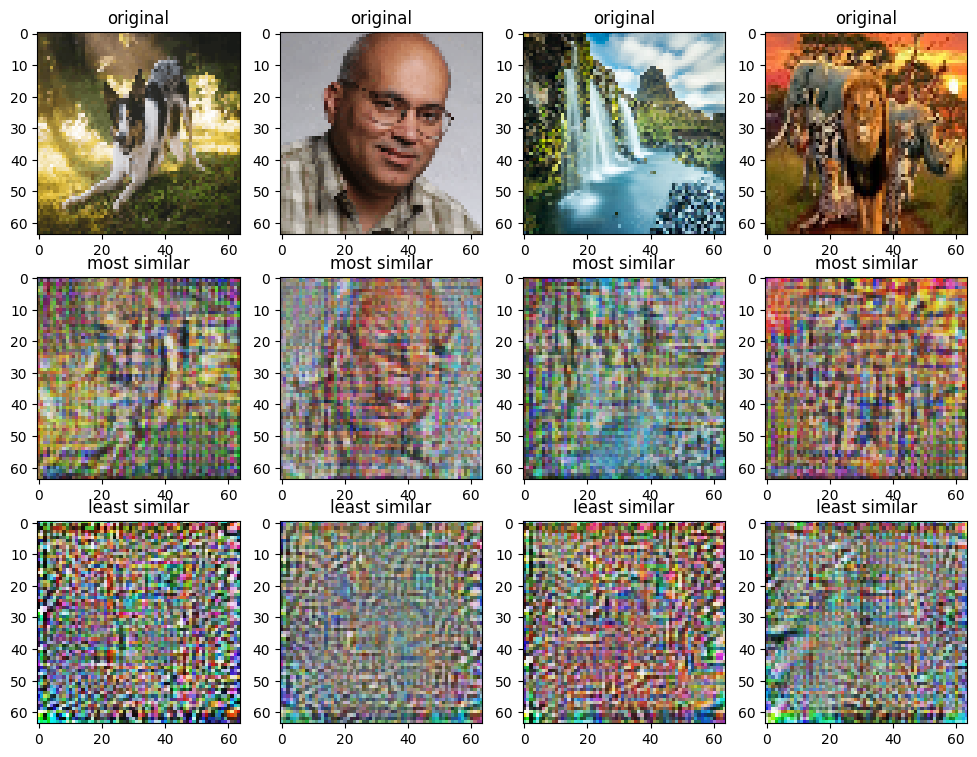

-2.0115244388580322


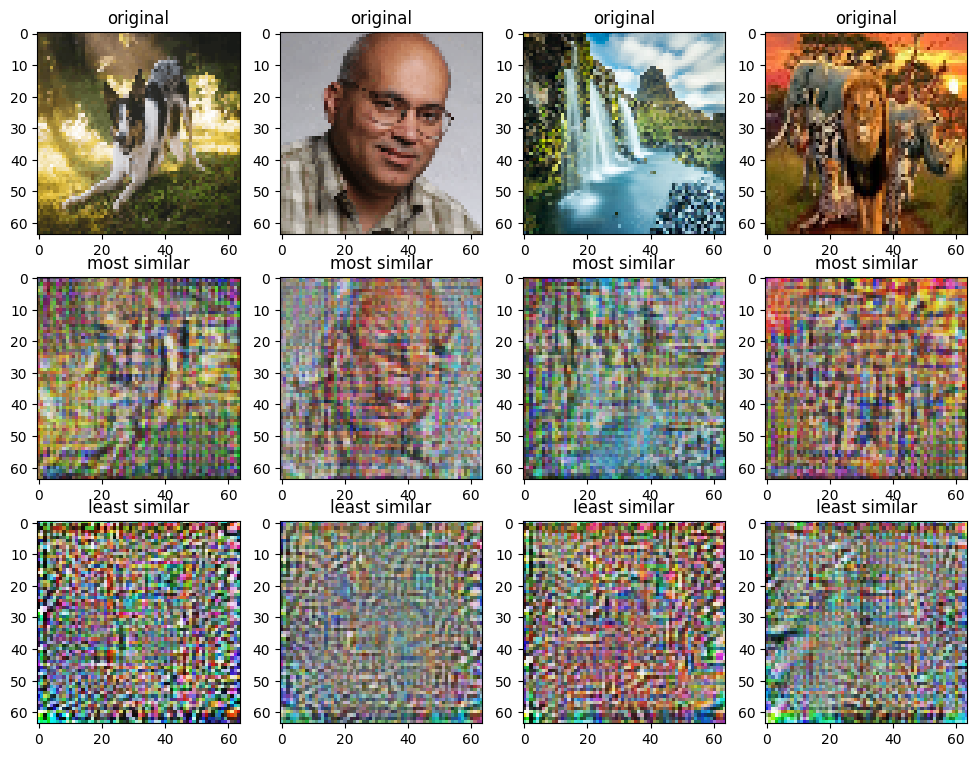

-2.014805793762207


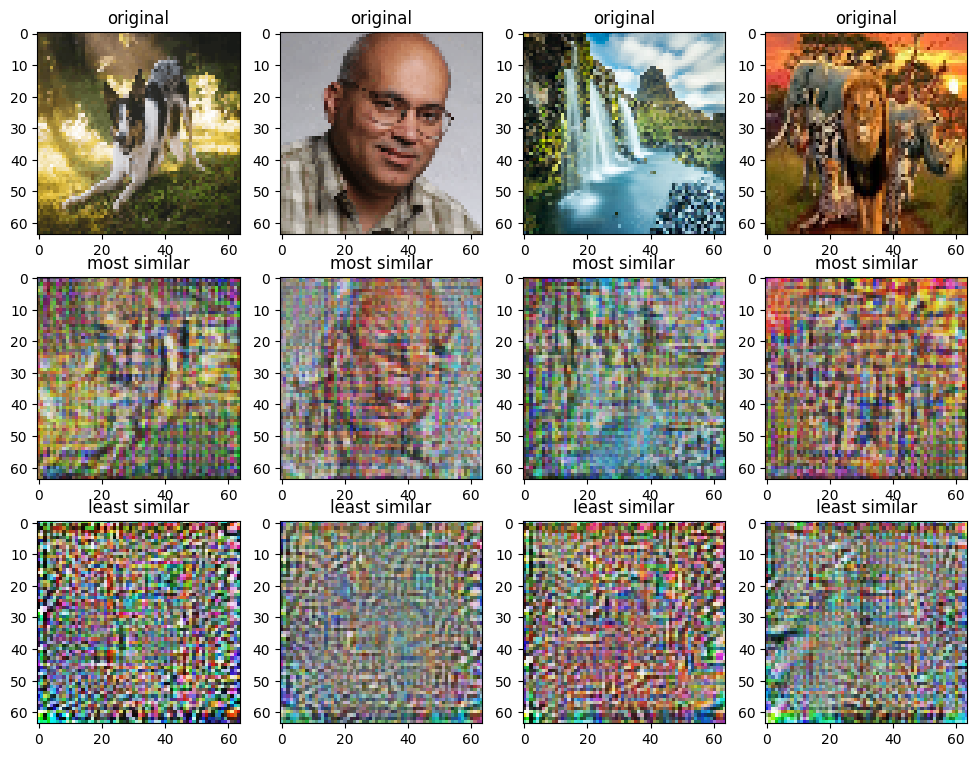

-2.017854690551758


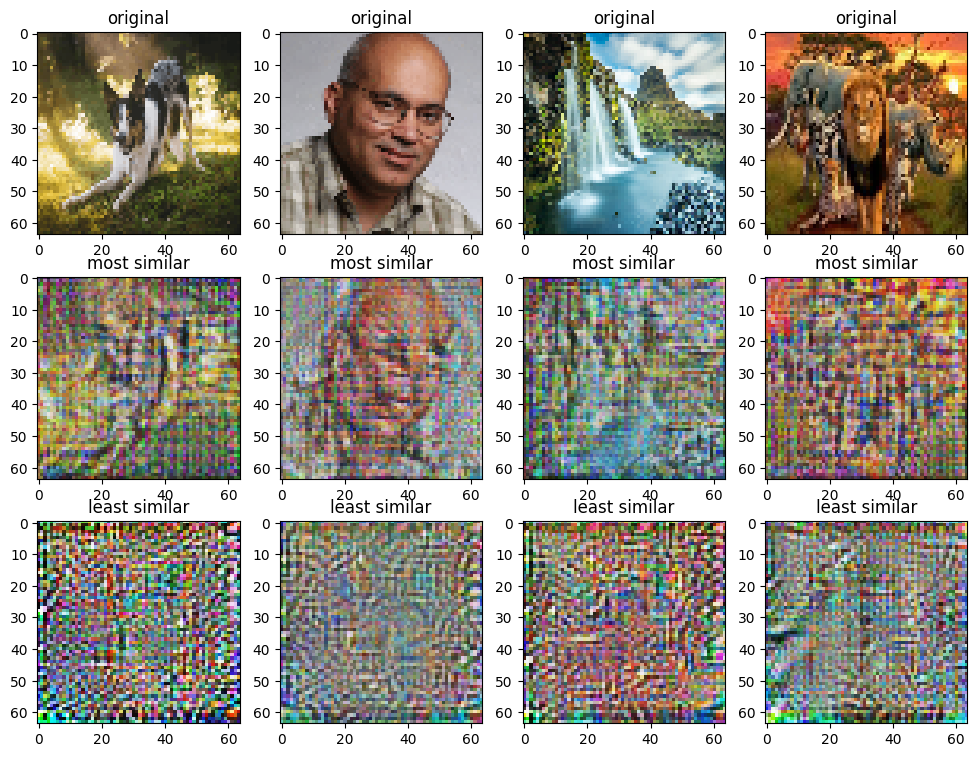

-2.0207412242889404


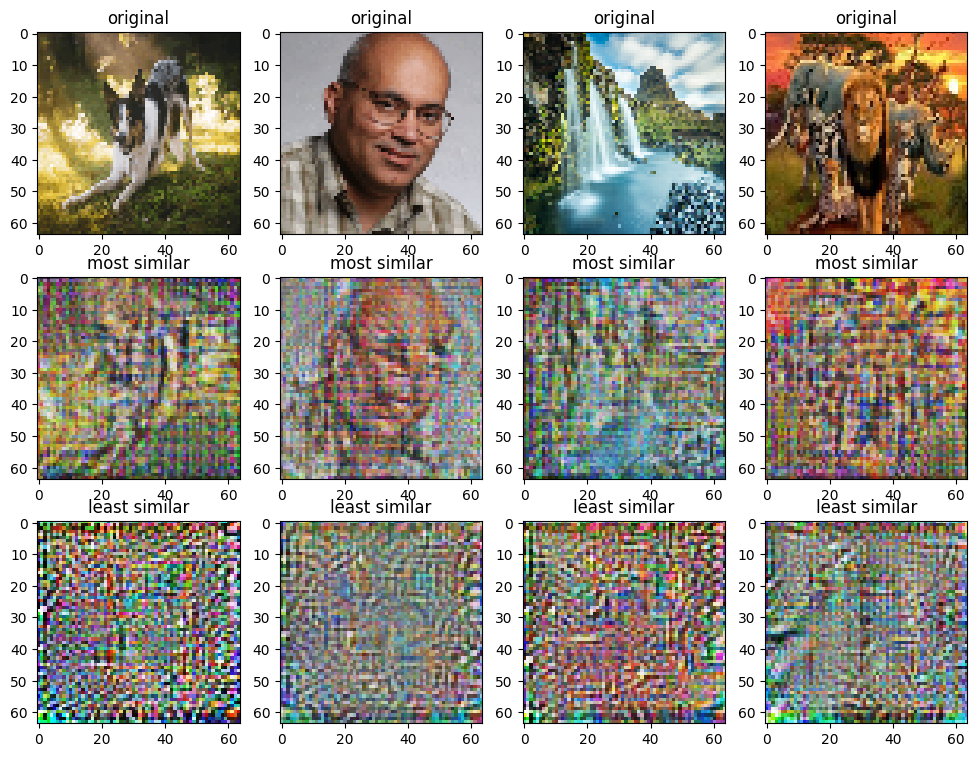

-2.0332369804382324


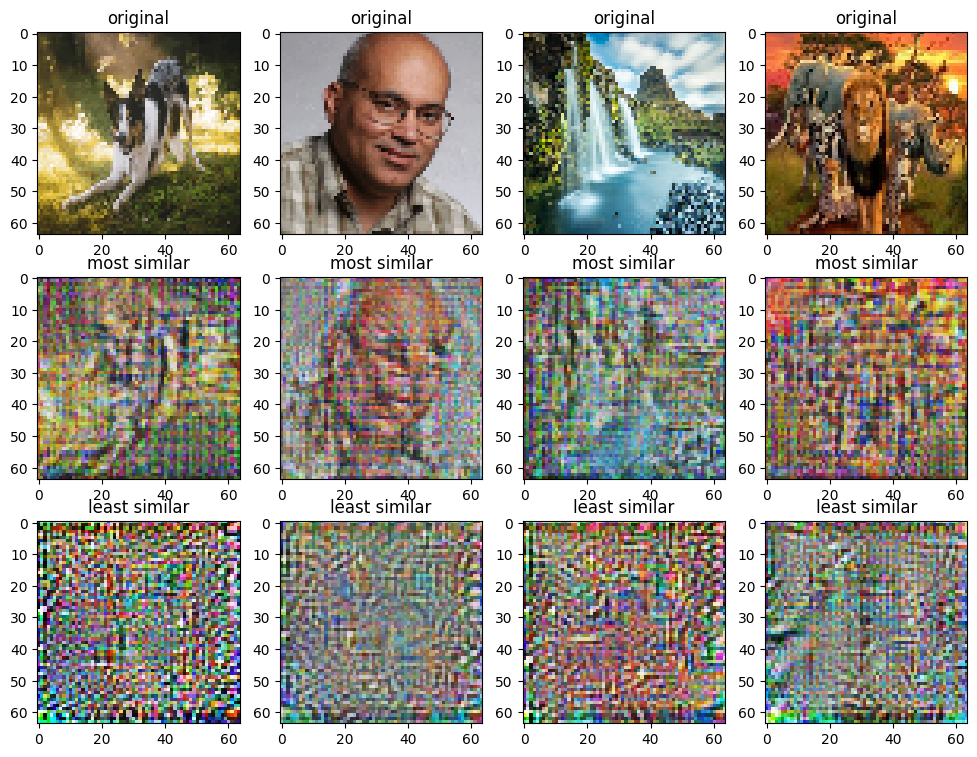

-2.036466360092163


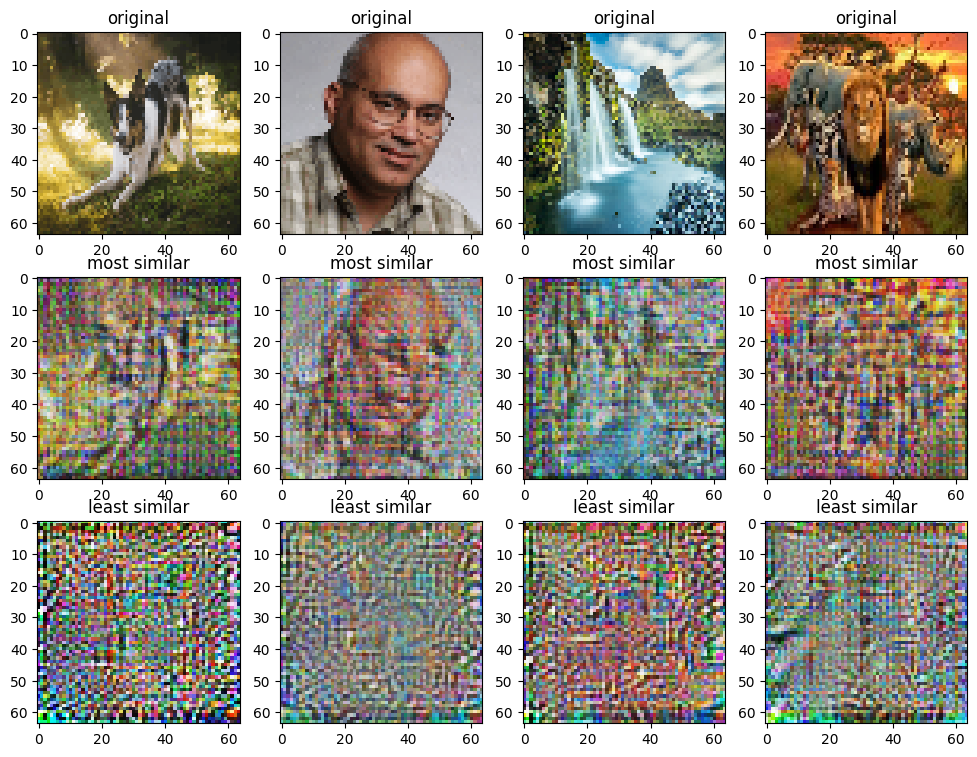

-2.039433717727661


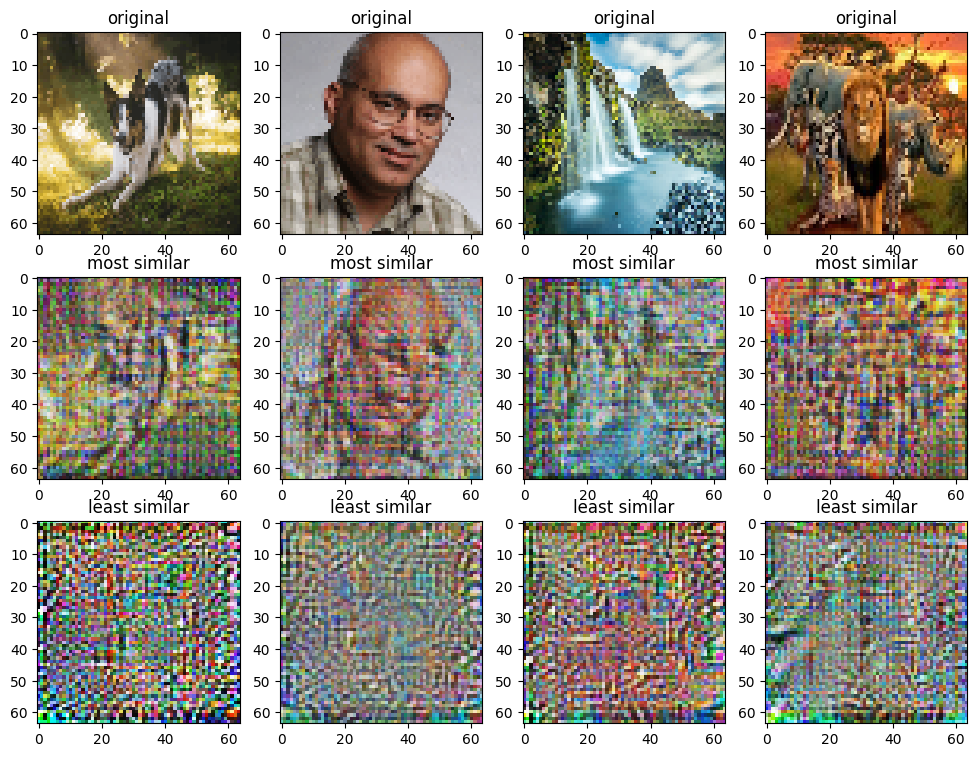

-2.0421478748321533


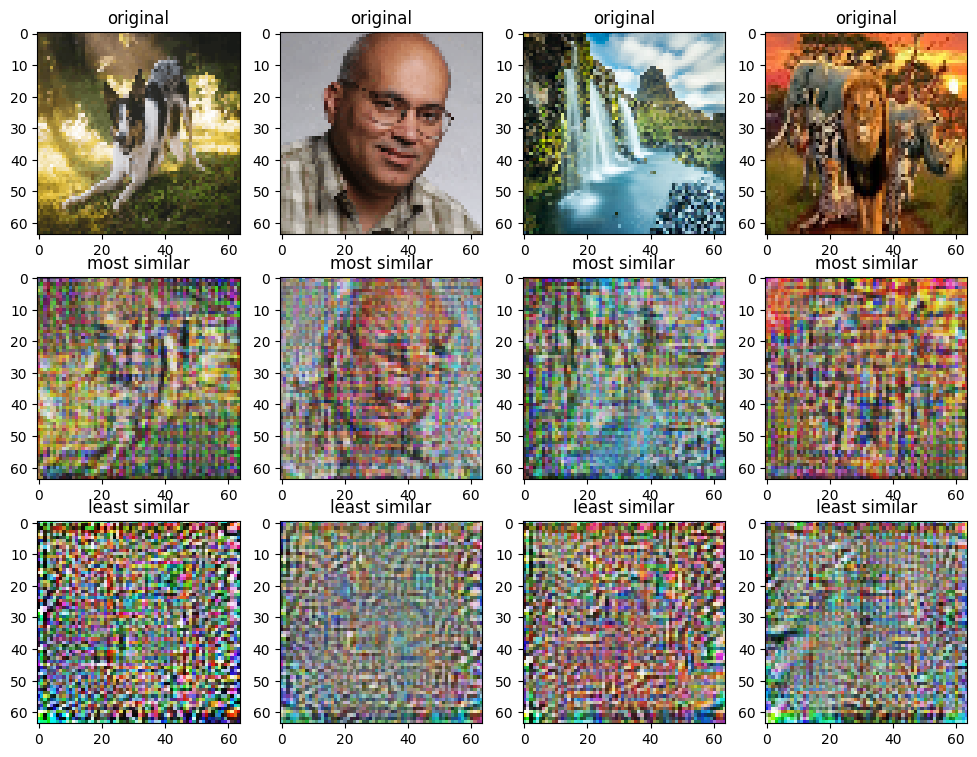

-2.042057752609253


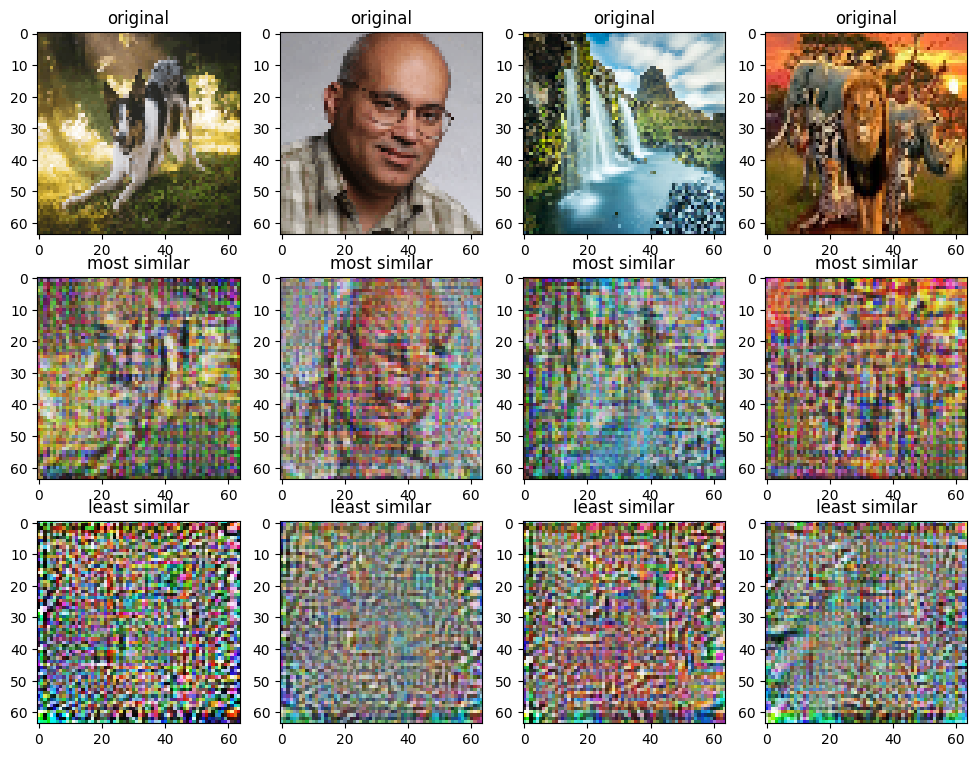

-2.046053647994995


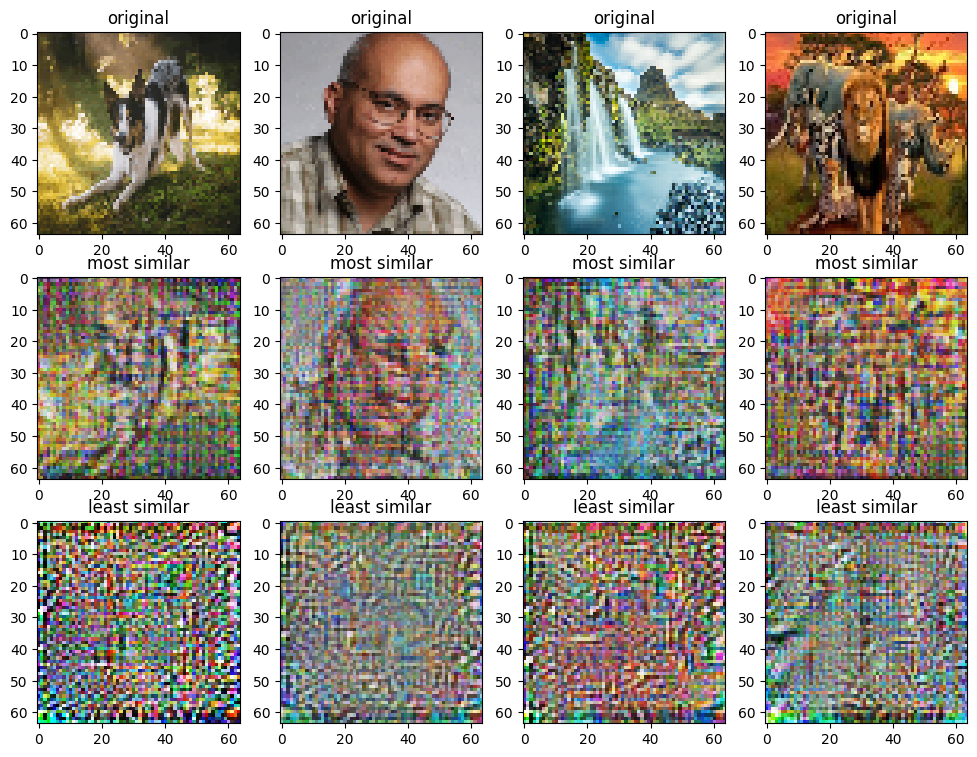

In [9]:
img_size = (64, 64)
trans_load = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize(img_size),
])

imgs = ['imgs/dog.png', 'imgs/malik.jpg', 'imgs/waterfall.jpg', 'imgs/animals.jpg']
targets = torch.stack([trans_load(plt.imread(img)[..., :3]) for img in imgs])
print(targets.shape)

# dofs = ImageCPPN(n_batches=len(targets)*2, **cppn_params)
dofs = PixelDOFs(n_batches=len(targets)*2, img_size=img_size)

dofs, targets, net_lpips = dofs.to(device), targets.to(device), net_lpips.to(device)
opt = torch.optim.Adam(dofs.parameters(), lr=1e-3)

for i_step in tqdm(range(10000)):
    imgs = dofs.generate_image(img_size)
    imgsa, imgsb = imgs[:len(targets)], imgs[len(targets):]
    
    loss = net_lpips(targets, imgsa).mean()-net_lpips(targets, imgsb).mean()
    # loss = (targets-imgsa).pow(2).mean()-(targets-imgsb).pow(2).mean()
    
    opt.zero_grad()
    loss.backward()
    opt.step()
    
    if i_step%200==0:
        print(loss.item())
        plt.figure(figsize=(3*len(targets), 3*3))
        for i in range(len(targets)):
            plt.subplot(3, len(targets), i+1);plt.imshow(targets[i].detach().cpu().permute(1,2,0)); plt.title('original')
            plt.subplot(3, len(targets), i+1+len(targets));plt.imshow(imgsa[i].detach().cpu().permute(1,2,0)); plt.title('most similar')
            plt.subplot(3, len(targets), i+1+2*len(targets));plt.imshow(imgsb[i].detach().cpu().permute(1,2,0)); plt.title('least similar')
        plt.show()


In [17]:
imgs = dofs.generate_image((32,32)).reshape(2, 4, 3, 64, 64)

In [26]:
def calc_pairwise_lpips_dist(net_lpips, imgs):
    """
    imgs.shape should be (b, L, 3, h, w)
    returns a tensor of (b, L, L) corresponding to pairwise distances in L
    """
    b, L = imgs.shape[:2]
    ans = torch.zeros(b, L, L, dtype=imgs.dtype, device=imgs.device)
    for i in range(L):
        for j in range(L):
            if i>j:
                ans[:, i, j] = net_lpips(imgs[:, i], imgs[:, j])[:, 0, 0, 0]
    ans = ans+ans.transpose(-1, -2) # make it symmetric
    return ans

In [27]:
calc_pairwise_lpips_dist(net_lpips, imgs[[0]])

tensor([[[0.0000, 0.4427, 0.3209, 0.5425],
         [0.4427, 0.0000, 0.5059, 0.7152],
         [0.3209, 0.5059, 0.0000, 0.5695],
         [0.5425, 0.7152, 0.5695, 0.0000]]], device='cuda:0',
       grad_fn=<AddBackward0>)

In [28]:
calc_pairwise_lpips_dist(net_lpips, imgs[[1]])

tensor([[[0.0000, 0.2097, 0.3691, 0.8935],
         [0.2097, 0.0000, 0.3237, 0.6946],
         [0.3691, 0.3237, 0.0000, 0.9981],
         [0.8935, 0.6946, 0.9981, 0.0000]]], device='cuda:0',
       grad_fn=<AddBackward0>)

In [ ]:
net_lpips(imgs[0], imgs[1])

tensor([[[[2.1353]]],


        [[[1.9513]]],


        [[[2.0811]]],


        [[[2.0285]]]], device='cuda:0', grad_fn=<AddBackward0>)

In [122]:
device = 'cuda:0'
torch.manual_seed(0)
latents = torch.randn(2, 10).to(device)
# cppn_params = dict(n_hidden=100, n_layers=20, activation=torch.tanh, normalization='coordinate', residual=False)
cppn_params = dict(n_hidden=100, n_layers=20, activation=torch.tanh, normalization=None, residual=False)
dofs = ImageCPPN(n_batches=1, **cppn_params, dim_latent=10).to(device)
imgs = torch.stack([dofs.generate_image(img_size, latent) for latent in latents], dim=1) # b, l, 3, h, w

In [83]:
imgs.diff(dim=1).abs().max()

tensor(5.7817e-06, device='cuda:0', grad_fn=<MaxBackward1>)

In [84]:
latents

tensor([[-1.1258, -1.1524, -0.2506, -0.4339,  0.5988, -1.5551, -0.3414,  1.8530,
          0.4681, -0.1577],
        [ 1.4437,  0.2660,  1.3894,  1.5863,  0.9463, -0.8437,  0.9318,  1.2590,
          2.0050,  0.0537]], device='cuda:0')

In [108]:
a = torch.randn(100, 10, 20)*10000
b = (a-a.mean(dim=(-1,-2), keepdim=True))/(a.var(dim=(-1,-2), keepdim=True)+1e-5).sqrt()
c = nn.functional.layer_norm(a, normalized_shape=(10, 20))

  0%|          | 0/40 [00:00<?, ?it/s]

-0.019040264189243317


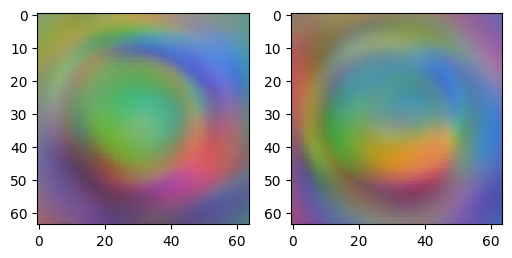

-0.06415998935699463


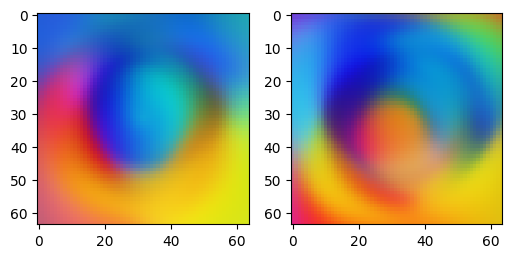

-0.3960784077644348


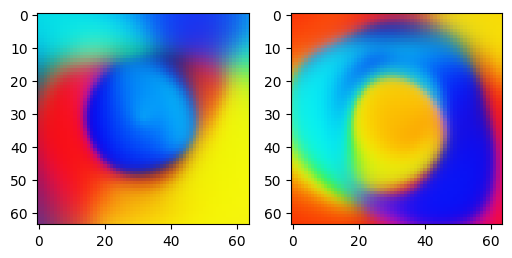

-0.41603273153305054


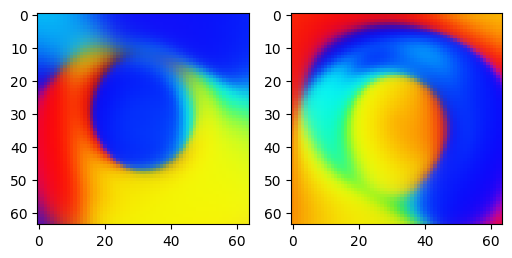

-0.6341837644577026


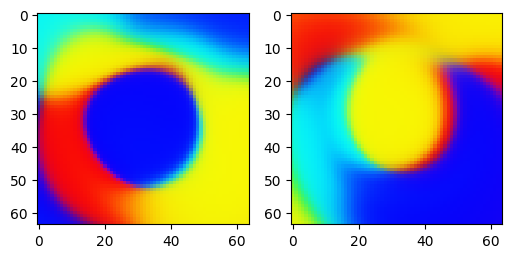

-0.7514476776123047


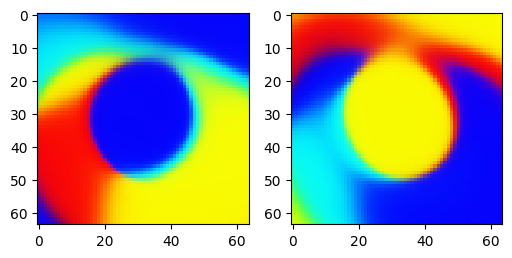

-0.8101805448532104


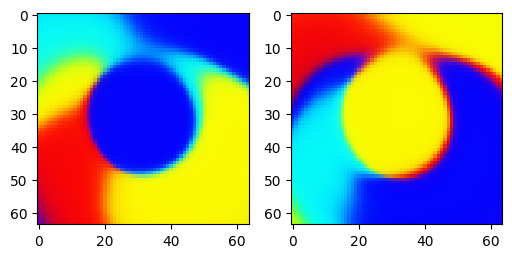

-0.8387703895568848


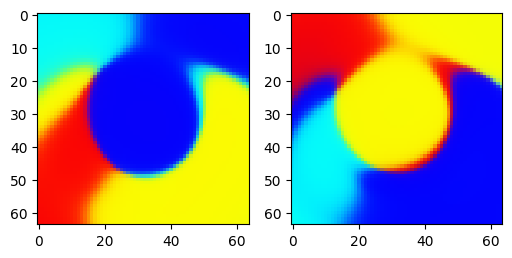

-0.8699663877487183


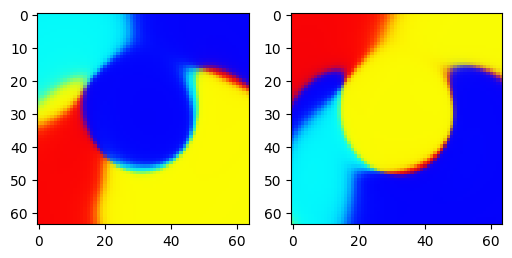

-0.8910588026046753


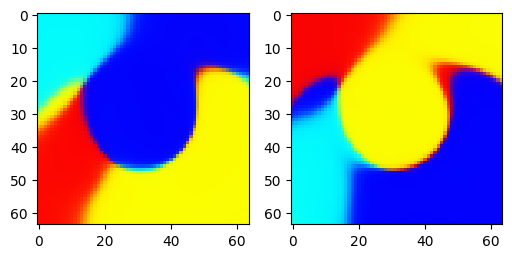

-0.9046086668968201


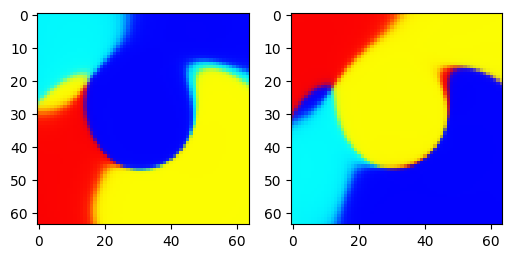

-0.9179877042770386


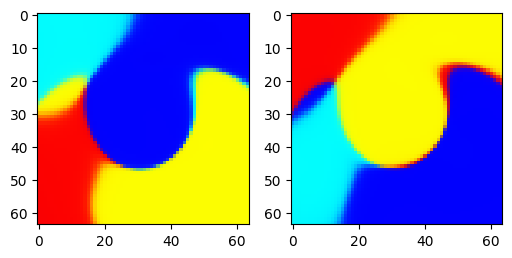

-0.9241809844970703


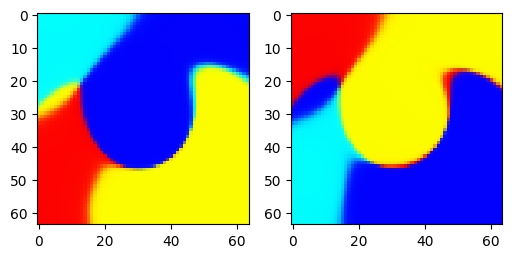

-0.9386386871337891


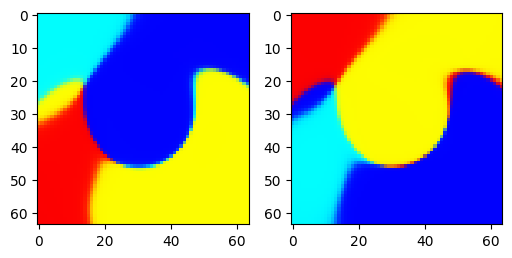

In [125]:
device = 'cuda:0'
torch.manual_seed(0)
latents = torch.randn(2, 10).to(device)
cppn_params = dict(n_hidden=100, n_layers=20, activation=torch.tanh, normalization='coordinate', residual=False)
# cppn_params = dict(n_hidden=100, n_layers=20, activation=torch.tanh, normalization=None, residual=False)
dofs = ImageCPPN(n_batches=1, **cppn_params, dim_latent=10).to(device)

opt = torch.optim.Adam(dofs.parameters(), lr=1e-3)

for i_step in tqdm(range(40)):
    imgs = torch.stack([dofs.generate_image(img_size, latent) for latent in latents], dim=1) # b, l, 3, h, w
    imgs = imgs[0] # l, 3, h, w
    
    loss = -(imgs[0]-imgs[1]).pow(2).mean()# - imgs[0].std()
    opt.zero_grad()
    loss.backward()
    opt.step()
    
    if i_step%3==0:
        print(loss.item())
        fig, axs = plt.subplots(1, len(imgs), figsize=(len(imgs)*3, 3))
        for ax, img in zip(axs, imgs):
            ax.imshow(img.permute(1, 2, 0).detach().cpu().numpy())
        plt.show()
    



In [31]:
trans_resize = transforms.Resize((224, 224))
utils.single_batch_map(trans_resize, torch.randn(4, 2, 3, 224, 224), (3, 224, 224))

torch.Size([4, 2, 3, 224, 224])

In [ ]:
# TODO run CLIP optimization w pixels
# TODO run CLIP optimization w CPPN
# TODO run CLIP+lpips optimization w CPPN w/ latent

In [184]:
device = 'cuda:1'
texts = ["mountains with a waterfall", "cheetah eating a banana", "unicorn and rainbow"]
texts = ["A red apple", "A green tree", "The bright sun"]


net_clip = net_clip.to(device).eval()

with torch.no_grad():
    texts_tokens = clip.tokenize(texts).to(device)
    texts_features = net_clip.encode_text(texts_tokens).detach() # (batch, embed_dim)

dofs = ImageCPPN(n_batches=len(texts), **cppn_params)
# dofs = PixelDOFs(n_batches=len(targets)*2, img_size=img_size)

dofs = dofs.to(device)

opt = torch.optim.Adam(dofs.parameters(), lr=1e-3, weight_decay=1e-6)

for i_step in tqdm(range(1000)):
    imgs = dofs.generate_image()
    
    imgs_aug = optimization.augment_img(imgs, 10, augment='crops', keep_original=True) # (batch, n_augs, 3, h, w)
    imgs_features = utils.single_batch_map(net_clip.encode_image, imgs_aug, imgs_aug.shape[-3:])
    dots = torch.cosine_similarity(imgs_features, texts_features[:, None], dim=-1)
    loss = -dots.mean()
    opt.zero_grad()
    loss.backward()
    opt.step()
    # print(clip_model.visual.conv1.weight.grad.abs().mean().item())

# def callback(i_iteration, texts, imgs, imgs_aug, imgs_features, texts_features, dots, loss):
#     if i_iteration%200==0:
#         dots_img = dots.mean(dim=-1).tolist()
#         plt.figure(figsize=(5*len(imgs), 5))
#         for i_img, img in enumerate(imgs):
#             plt.subplot(1, len(imgs), i_img+1)
#             plt.title(texts[i_img] + f', match: {dots_img[i_img]:.4f}')
#             plt.imshow(to_np(img.permute(1, 2, 0)))
#         plt.show()


  0%|          | 0/1000 [00:00<?, ?it/s]

torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3, 1024])
torch.Size([3, 10, 1024]) torch.Size([3,

KeyboardInterrupt: 

  0%|                                                                                                                                                                                                                | 0/2000 [00:00<?, ?it/s]

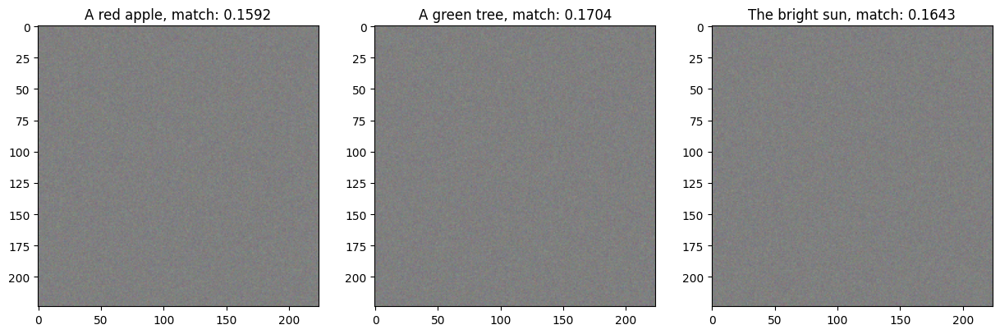

 10%|███████████████████▋                                                                                                                                                                                  | 199/2000 [00:16<02:25, 12.39it/s]

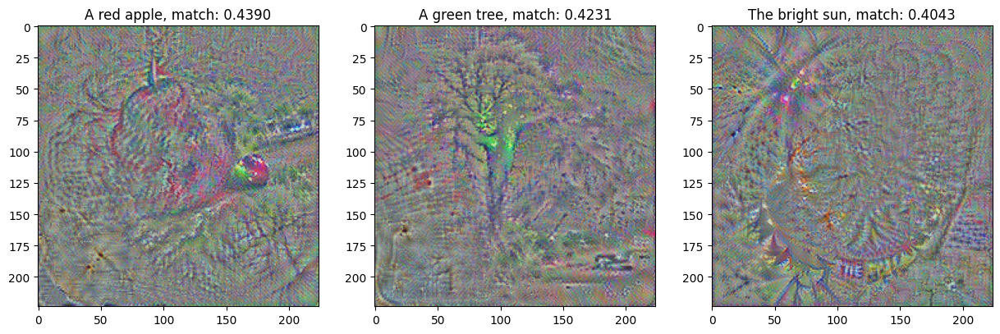

 16%|██████████████████████████████▉                                                                                                                                                                       | 313/2000 [00:27<02:26, 11.55it/s]

KeyboardInterrupt



In [13]:
torch.manual_seed(2)

texts = ["mountains with a waterfall", "cheetah eating a banana", "unicorn and rainbow"]
texts = ["A red apple", "A green tree", "The bright sun"]

def callback(i_iteration, texts, imgs, imgs_aug, imgs_features, texts_features, dots, loss):
    if i_iteration%200==0:
        dots_img = dots.mean(dim=-1).tolist()
        plt.figure(figsize=(5*len(imgs), 5))
        for i_img, img in enumerate(imgs):
            plt.subplot(1, len(imgs), i_img+1)
            plt.title(texts[i_img] + f', match: {dots_img[i_img]:.4f}')
            plt.imshow(to_np(img.permute(1, 2, 0)))
        plt.show()
    
optimization.optimize_imgs(net_clip, texts, imgs='pixel', n_iterations=2000, lr=5e-2, device=device, callback=callback)

(2,)

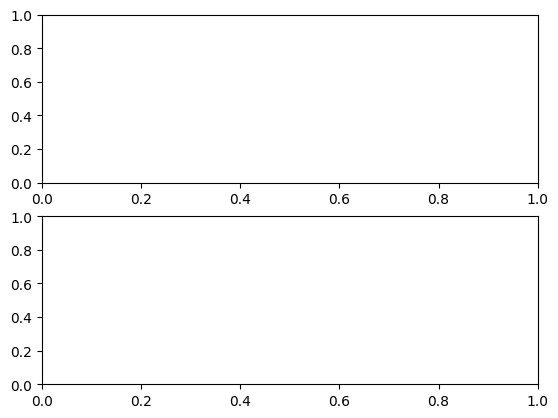

In [190]:
fig, axs = plt.subplots(2, 1)
axs.shape

In [207]:
device = 'cuda:2'

img_size = (224, 224)
trans_load = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize(img_size),
])
img = trans_load(plt.imread('imgs/red_dog.jpg')).to(device)
text = 'A red dog'

net_clip = net_clip.to(device)

tokens_text = clip.tokenize([text]).to(device)

with torch.no_grad():
    features_texts = net_clip.encode_text(tokens_text).detach() # (b, embed_dim)
    
features_imgs = net_clip.encode_image(img[None])

torch.cosine_similarity(features_imgs, features_texts, dim=-1)

tensor([0.2412], device='cuda:2', dtype=torch.float16, grad_fn=<SumBackward1>)

In [20]:
dofs = ImageCPPN(n_batches=1, **cppn_params, dim_latent=10)

latents = torch.randn(4, 10)
dofs.generate_image((32, 32), latent=latents[0])

tensor([[[[0.6425, 0.6400, 0.6270,  ..., 0.6490, 0.6666, 0.6317],
          [0.5442, 0.5135, 0.4619,  ..., 0.6464, 0.6518, 0.5656],
          [0.4402, 0.3693, 0.3424,  ..., 0.6298, 0.5539, 0.5430],
          ...,
          [0.3645, 0.4186, 0.4308,  ..., 0.3714, 0.3806, 0.4161],
          [0.3278, 0.3561, 0.3686,  ..., 0.4598, 0.5080, 0.4415],
          [0.3301, 0.3385, 0.3568,  ..., 0.5416, 0.5167, 0.4236]],

         [[0.4408, 0.4186, 0.4307,  ..., 0.6305, 0.6071, 0.5525],
          [0.4320, 0.4419, 0.4131,  ..., 0.6285, 0.6216, 0.4905],
          [0.4715, 0.4642, 0.3917,  ..., 0.4703, 0.3549, 0.4357],
          ...,
          [0.3952, 0.4263, 0.4253,  ..., 0.3700, 0.3558, 0.3139],
          [0.3723, 0.4220, 0.4216,  ..., 0.4154, 0.3886, 0.3169],
          [0.3676, 0.4191, 0.4124,  ..., 0.4225, 0.3425, 0.3226]],

         [[0.3364, 0.3108, 0.3305,  ..., 0.6103, 0.5812, 0.5786],
          [0.3299, 0.3679, 0.4323,  ..., 0.5985, 0.6152, 0.5839],
          [0.4450, 0.5398, 0.5636,  ..., 0